#BIO491

#Packages Installation

In [1]:
!pip install gprofiler-official
!pip install requests
!pip install igraph
!pip install matplotlib
!pip install uniprot-id-mapper
!pip install BeautifulSoup4
!pip install 'matplotlib-venn[shapely]'

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.1/3.1 MB 17.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 45.9/45.9 kB 1.8 MB/s eta 0:00:00


#Functions

In [2]:
import pandas as pd
import csv
import numpy as np
from gprofiler import GProfiler
from ast import literal_eval
import requests
import igraph as ig
import matplotlib.pyplot as plt
from matplotlib_venn import venn2, venn2_circles
from UniProtMapper import ProtMapper
import time
from bs4 import BeautifulSoup
import re
import scipy.stats as stats
from scipy.stats import mannwhitneyu
from scipy.stats import linregress
from math import log
from math import log10



def protein_to_protein_accession_conversion (query_list):

    mapper = ProtMapper()

    query = ','.join(query_list)

    from_db = 'UniProtKB_AC-ID'
    to_db = 'UniProtKB'
    ids = query


    results_df, failed_list  = mapper.get(ids=ids, from_db=from_db, to_db=to_db) #mapper.get returns a tuple with a df of the results, and a list with the ids that were not found
    #just a note: the failed list contains all the ids in a single string e.g ['P49913,P27695,P0DMM9']

    # fetching(len(query_list))

    dictionary = {}
    for i in range (len(results_df)):
      dictionary[results_df.loc[i, 'From']] = {'Acc': results_df.loc[i, 'Entry']}

    print ('\n Converted Proteins:', len(dictionary))
    print (dictionary)

    element = failed_list[0] #the element is a string that contains all the query proteins (e.g. 'P49913,P27695,P0DMM9')
    all_proteins = element.split(',') #this is a list


    # print (all_proteins)
    print ('\n All proteins:', len(all_proteins))

    common_proteins = list (set(all_proteins).intersection(set(dictionary.keys())))
    print ('\n Converted Proteins:', len(common_proteins))

    not_found= []

    for protein in all_proteins:
      if protein not in common_proteins:
        not_found.append(protein)
        dictionary[protein] = {'Acc': 'None'}
        with open ('not_found_proteins_acc.txt', 'w') as file: #append the proteins that were not found in the 'not_found_proteins.tsv' file
          file.write(f'%s\n' % (protein))

    print ('\n Not found:', len(not_found))


    return dictionary #returns a dictionary

def protein_to_gene_conversion(query_list):
    '''
    The protein_to_gene_conversion function takes as argument a list with uniprot ids and returns a dictionary
    that has as key the uniprot id and as value a dictionary with equivalent gene name {'Uniprot id': {'Gene': Gene name}}.
    '''

    protein_to_gene_conversion.counter += 1


    mapper = ProtMapper()

    query = ','.join(query_list)

    from_db = 'UniProtKB_AC-ID'
    to_db = 'Gene_Name'
    ids = query


    results_df, failed_list  = mapper.get(ids=ids, from_db=from_db, to_db=to_db) #mapper.get returns a tuple with a df of the results, and a list with the ids that were not found
    #just a note: the failed list contains all the ids in a single string e.g ['P49913,P27695,P0DMM9']

    # fetching(len(query_list))

    dictionary = {}
    for i in range (len(results_df)):
      dictionary[results_df.loc[i, 'From']] = {'Gene': results_df.loc[i, 'To']}

    print ('\n Converted Proteins:', len(dictionary))
    print (dictionary)

    element = failed_list[0] #the element is a string that contains all the query proteins (e.g. 'P49913,P27695,P0DMM9')
    all_proteins = element.split(',') #this is a list


    # print (all_proteins)
    print ('\n All proteins:', len(all_proteins))

    common_proteins = list (set(all_proteins).intersection(set(dictionary.keys())))
    print ('\n Converted Proteins:', len(common_proteins))

    not_found= []
    filename = f'not_found_proteins_({protein_to_gene_conversion.counter}).txt'

    with open (filename, 'w') as txtfile: #append the proteins that were not found in the 'not_found_proteins.tsv' file
      for protein in all_proteins:
        if protein not in common_proteins:
          not_found.append(protein)
          dictionary[protein] = {'Gene': 'None'}
          txtfile.write(f'%s\n' % (protein))

    print ('\n Not found:', len(not_found))


    return dictionary #returns a dictionary

def gene_to_protein_conversion(query_list):

    '''
    The gene_to_protein_conversion function takes as argument a list with gene names and returns a dictionary
    that has as key the gene name and as value a dictionary with equivalent protein id {'Gene name': {'Protein': Uniprot id}}.
    '''
    gene_to_protein_conversion.counter += 1
    # counter +=1

    count_none = 0
    gp = GProfiler(
        user_agent='ExampleTool',  # optional user agent
        return_dataframe=True  # return pandas dataframe or plain python structures
    )
    print("\n Total proteins before conversion: ", len(query_list))

    # convert the uniprot ids to the equivalent gene accession numbers. the results are saved in a df
    # query_genes = ','.join(query_list)

    converted_df = gp.convert(organism='hsapiens',
                              query=query_list,
                              target_namespace='UNIPROTSWISSPROT_ACC')

    print(converted_df.head().to_string())
    # print(converted_df)

    # fetching (len(query_list))
    dictionary = {}
    filename = f'not_found_genes_({gene_to_protein_conversion.counter}).txt'

    with open (filename, 'w') as txtfile: #append the proteins that were not found in the 'not_found_genes.txt' file
      for i in range(len(converted_df)):
          gene = converted_df.loc[i, 'incoming']
          protein = converted_df.loc[i, 'converted']

          if protein != 'None':
              if gene not in dictionary.keys():
                  dictionary[gene] = {'Protein': protein}
          else:
              dictionary[gene] = {'Protein': 'None'}
              count_none += 1
              txtfile.write(f'%s\n' % (gene))


    incoming_proteins = list(converted_df.loc[:, 'incoming'])
    print ('\n Incoming_proteins:', len(incoming_proteins))
    print("\n Total proteins after conversion: ", (len(dictionary.keys())-count_none))
    print ("\n Total unconverted proteins: ", count_none)
    print ('Dictionary', dictionary)


    return dictionary #returns a dictionary

def gene_enrichment(dictionary, filename):

    '''
    The gene_enrichment function takes as arguments a dictionary (describe what this dictionary contains) and the name of the file where
    the results of the gene enrichment analysis will be saved.
    '''

    #query_genes = protein_to_gene_conversion(dictionary) #this is a list
    query_genes = []
    for uniprot_id in dictionary.keys():
        gene = dictionary[uniprot_id]['Gene']
        query_genes.append(gene)

    gp = GProfiler(
        user_agent='ExampleTool',  # optional user agent
        return_dataframe=True  # return pandas dataframe or plain python structures
    )

    query = gp.profile(organism='hsapiens',
                       query=query_genes,
                      #  sources=['GO:MF'],
                       sources=["GO:MF", "GO:CC", "GO:BP", "KEGG", "REAC", "WP", "HPA", "CORUM", "HP"],
                       # sources=["GO:MF", "GO:CC", "GO:BP"],
                       no_evidences=False)

    print("\n Total genes after enrichment: ", len(query))

    go_terms = list((query.loc[:, "native"]))  # pathways with their unique accession number
    print('\n Total GO terms:', len(go_terms))
    name = list((query.loc[:, 'name']))  # a description of the pathway
    print('\n Total names:', len(name))
    p_value = list(query.loc[:, "p_value"])
    print('\n Total p-values:', len(p_value))
    intersections = list(query.loc[:, "intersections"])  # a list with the group of proteins that participate in the equivalent pathway
    print('\n Total intersections:', len(intersections))
    #
    column_labels = ['p-value', 'GO terms', 'Pathway(name)', 'Intersections'] #this is a list that contains column names for the csv file
    column_data = [p_value, go_terms, name, intersections] #this is a list that contains all the lists with the data that I want to include in the csv file
    new_csv_file(column_labels, column_data, filename, True)

def read_gene_enrichment_results(filename):
    '''
    The read_gene_enrichmenet_results function takes as argument the name of the file that contains the results from
    the gene enrichment analysis and returns a dictionary: 'go term' = {'p-value': p_value, 'Pathway(name)': pathway, 'Intersections': intersections}
    '''

    csv_file = filename
    df = pd.read_csv(csv_file, converters={'Intersections': literal_eval})  # the converter here is applied for the data under the 'Intersections' column
    # since they were saved as str and not as lists
    print(df.head().to_string())
    #print(df.columns.values)
    go_terms = list(df.loc[:, 'GO terms'])

    dictionary = {}
    for i in range(len(go_terms)):
        go_term = go_terms[i]
        p_value = float(df.loc[i, 'p-value'])
        pathway = (df.loc[i, 'Pathway(name)'])
        intersections = (df.loc[i, 'Intersections'])
        dictionary[go_term] = {'p-value': p_value, 'Pathway(name)': pathway, 'Intersections': intersections}

    return (dictionary)
    # return (go_terms, p_value, cellular_process, intersections)

def new_csv_file (column_labels, column_data, filename, index_status):

    '''
    The new_csv_file function aims to create a new csv file using a dictionary which is then converted to a df.
    It takes as arguments, a list with the names of the column in the new file, a list of lists with the data under each column, and the name of the file.
    The index_status takes True or False boolean values and the user selects if the column index will be included or not at the new file.
    '''
    size = len(column_data[0])
    dictionary = {}
    for label, data in zip(column_labels, column_data):
        #print (data)
        dictionary[label] = data

    df=pd.DataFrame(dictionary, index = range(size))
    # print (df)

    df.to_csv(filename, index=index_status, sep=',')

    print (f'\n The file {filename} has been saved!')


def uniprot_query (entries_list, fields_list):

  '''
    entries_list: a list with the protein id (e.g. 'WIPF1_HUMAN'), protein accession (e.g. 'O43516' ), or gene name (e.g. 'WIPF1') of the proteins of interest

    fields_list: is a list with the fields of each entry you want to query in string format (e.g. 'protein_name', 'cc_function'). The field names can be found in the uniprot documentation (https://www.uniprot.org/help/return_fields)

    Just a note regarding the field_list: The following code block runs only with filds_lists 'protein_name'. Thus, if any other fields are required, the appropriate changes must be made.
  '''
  query_list = ','.join(entries_list)

  url = 'https://rest.uniprot.org/uniprotkb/search?'

  error_messages = {
      '400':' Bad Request: The request was invalid.',
      '401': 'Unauthorized: Authentication failed.',
      '404': 'Not Found: The requested resource does not exist.',
      '414': 'Request-URI Too Long: The request URI is too long.',
      '500': 'Internal Server Error: The server encountered an error.'
  }


  entries_dictionary = {}
  for entry in entries_list: #entry is the uniprot accession
    params = {
      'query': entry,
      'fields': fields_list
      }

    response = requests.get(url, params=params)
    results_dict = response.json()

    if response.status_code == 200:
      # print ('\n Entry:', entry)
      results_list = results_dict['results'] # query['results'] is a list of dictionaries,
      # print ('\n Results list:', results_list)

      result = results_list[0] #result is a dictionary
      # print ('\n Result: ', result)

      protein_name = 'None'
      if result != {}:

        protein_description = result['proteinDescription'] #this is a dictionary

        if 'recommendedName' in protein_description.keys():
          protein_name = protein_description['recommendedName']['fullName']['value']

      # else:
      #   protein_name = 'None'


      entries_dictionary.update({entry:{'Protein Name': protein_name}})

    elif response.status_code in error_messages.keys():
      print ('\n %s: %s'% (response.status_code, error_messages[str(response.status_code)]))

    else:
      print ('\n Error:', response.status_code)

  return entries_dictionary

def hippie_query_api (query_list,confidence_score, filename):

    '''
    This function takes as argument a file that contains only the enriched genes (previously created). From this file takes the uniprot ids and after making the query
    in hippie it finds the interactions of these proteins that were found experimentally. Then it prints a URL which when is clicked it downloads a tsv file with the results.
    It also saves the results from hippie in a tsv file 'hippie_results_0.63.tsv' where '0.63' is the confidence score that was used for the analysis.

    query_list: a list with the uniprot accession OR uniprot ids OR gene names
    confidence_score: the confidence score that is used for the analysis; it values from 0 to 1
    filename: the name of the file where the results from the query will be saved
    '''

    #Just a note: the beautiful soup package was used with the help of ChatGPT
    url = 'http://cbdm-01.zdv.uni-mainz.de/~mschaefer/hippie/queryHIPPIE.php?'

    error_messages = {
        '400':' Bad Request: The request was invalid.',
        '414': 'Request-URI Too Long: The request URI is too long.',
        '401': 'Unauthorized: Authentication failed.',
        '404': 'Not Found: The requested resource does not exist.',
        '500': 'Internal Server Error: The server encountered an error.'
    }
    # print (query_list)

    query=';'.join(query_list)

    parameters = {
        'proteins':query,
        'layers': '1', #layers = 0 to query interactions within the input set or 1 to query interactions between the input set and HIPPIE (optional, default = 1)
        'conf_thres': confidence_score,
        'out_type': 'conc_file'
    }

    response = requests.post(url,params=parameters) #make a query in HIPPIE using the uniprot ids from the file
    print ('\n Response:', response.status_code)
    if response.status_code == 200:

      soup = BeautifulSoup(response.content, 'html.parser')# Parse the HTML response to find the form
      form = soup.find('form', {'id': 'netQuery'})

      if form:
        # Extract form action URL and hidden input fields
        action_url = form.get('action')
        form_data = {input_tag.get('name'): input_tag.get('value') for input_tag in form.find_all('input')}
        # print ('\n form_data:', form_data)
        # print ('\n action_url:', action_url)
        full_action_url = requests.compat.urljoin(response.url, action_url)

        print(f"Submitting the next form to: {full_action_url}")

        #submit the form to download the file
        download_response = requests.post(full_action_url, data=form_data, stream=True)
        print ('Download HIPPIE results: ', response.url) #this is a link that downloads the tsv file with the results when it is clicked
        print ('Download_response:', download_response)

      else: #if form not found
        download_response = "No form found on the page."
        print("\n No form found on the page.")

    elif str(response.status_code) in error_messages.keys() :
      print ('\n %s: %s' % (response.status_code, error_messages[str(response.status_code)]))

    else: #if status code != 200 and there is not such response in error messages
      print ('\n Error:', response.status_code)

    with open(filename, 'w') as file:
        file.write(download_response.content.decode('utf-8'))

    print (f'\n The file {filename} has been saved!')


def read_hippie_results (input_filename, output_filename):

  '''
    The results from hippie_query have to be further analyzed in order to keep the proteins that interact and separate them from the not interacting proteins, which are then saved to a different file. Finally, the interactions pairs are formed

    input_file: the name of the file with the hippie results
    output_file: the name of the file where the interactions will be saved
  '''

  header = ['uniprot id 1', 'entrez gene id 1', 'gene name 1', 'uniprot id 2', 'entrez gene id 2', 'gene name 2', 'score'] #these are the columns of the conc file that hippie db returns
  index = 0
  #in case that a protein is not found the message "didn't find (.*) in the database, skipped it" appears at the top of the file before the results that start from header. So with the code below I try to obtain both the proteins not found and the results from HIPPIE

  with open(input_filename, 'r') as file:
    reader = csv.reader(file, delimiter='\t')
    # print (list(reader))
    for i, row in enumerate(reader):
      if row != header:
        if row != []:
          protein = ((row[0]))# if i write print (row) it will print a list, so in this way it prints a str with a message with the protein which was not found
          pattern = r"didn't find (.*) in the database, skipped it"

          matches = re.finditer(pattern, protein)
          for m in matches:
              protein = (m.group(1)) #m.group is a string

          with open ('not_found_proteins.txt', 'a') as file:
            if protein not in 'not_found_proteins.txt':
              file.write(f'%s\n' % (protein))
      else:
        index = i
        # print (index)
        break

  hippie_interactions_df = pd.read_table(input_filename, sep ='\t', skiprows = index)
  print (hippie_interactions_df.head().to_string())
  print (hippie_interactions_df.columns.values)


  hippie_interactions_df.dropna(inplace = True, subset = ['uniprot id 1', 'uniprot id 2']) #remove any rows with 'nan' values - note: 'nan' is considered as float

  #Prepare the columns for the creation of a new csv file
  confidence_values_list = list(hippie_interactions_df.loc[:, 'score'])
  interactor_A_list_uniprot_ids = list(hippie_interactions_df.loc[:, 'uniprot id 1']) #discuss why i have chosen
  interactor_B_list_uniprot_ids = list(hippie_interactions_df.loc[:, 'uniprot id 2'])

  print ('\n Interactor A uniprot ids:', len (interactor_A_list_uniprot_ids))
  print (interactor_A_list_uniprot_ids)
  print ('\n Interactor B uniprot ids:', len (interactor_B_list_uniprot_ids))
  print (interactor_B_list_uniprot_ids)

  hippie_protein_pairs = []

  for a, b in zip (interactor_A_list_uniprot_ids, interactor_B_list_uniprot_ids):
    pair = (a, b) #just a note here: if i remove the pair (b,a) which is the same with (a,b) maybe i lose biderectional associations
    if pair not in hippie_protein_pairs:
      hippie_protein_pairs.append(pair)

  #then i convert the uniprot ids to the equivalent gene names - just a note: The uniprot ids here are in the form of 'B2L11_HUMAN' and not accession numbers

  dict_genes = protein_to_protein_accession_conversion(interactor_A_list_uniprot_ids + interactor_B_list_uniprot_ids)
  # interactor_B_dict_genes = uniprot_id_mapping(interactor_B_list_uniprot_ids)

  hippie_gene_pairs = []
  scores = []
  interactor_A_list_genes = []
  interactor_B_list_genes = []

  for pair in hippie_protein_pairs:
    protein_a = pair[0]
    protein_b = pair[1]
    index = hippie_protein_pairs.index(pair)

    if protein_a in dict_genes.keys() and protein_b in dict_genes.keys():
      gene_a = dict_genes[protein_a]['Acc']
      gene_b = dict_genes[protein_b]['Acc']

      if gene_a != 'None' and gene_b != 'None':
        pair = (gene_a, gene_b)

        if pair not in hippie_gene_pairs:
          hippie_gene_pairs.append(pair)
          interactor_A_list_genes.append(gene_a)
          interactor_B_list_genes.append(gene_b)
          scores.append(confidence_values_list[index])


  print ('\n Hippie gene pairs: ', len(hippie_gene_pairs))
  print ('\n Scores ', len(scores), '\n', scores)


  #create a new file that contains the interactors and the confidence value
  column_labels = ['Interactor A', 'Interactor B', 'Confidence Value']
  column_data = [interactor_A_list_genes, interactor_B_list_genes, scores]
  filename = output_filename
  new_csv_file(column_labels, column_data, filename, True)

  return hippie_gene_pairs #this is a list with tuples, each one represents a pair


def new_ppi_network(nodes, edges, filename):
    pairs_list = []
    for pair in edges:
        # print (pair)
      if (pair[0] in nodes and pair[1] in nodes) and (pair[0] != 'None' or pair[1] != 'None'):
        query_protein_index = nodes.index(pair[0])  # pair is a tuple
        reference_protein_index = nodes.index(pair[1])  # pair is a tuple; the

        pairs_list.append((query_protein_index, reference_protein_index))
    dt = np.dtype('int', 'int')
    new_matrix = np.array(pairs_list, dtype=dt)

    # print(pairs_list)

    g = ig.Graph(pairs_list)
    # print(g)

    g.vs['nodes'] = nodes
    # g.vs['localization'] = localization
    # g.es['protein'] = edges
    layout = g.layout("kamada_kawai", maxiter = 1000)
    # col_dict = {
    #     'cytosol': 'blue',
    #     'nucleus': 'green',
    #     'mitochondrion': 'yellow',
    #     'None': 'white'
    # }
    # g.vs['color'] = [col_dict[loc] for loc in g.vs['localization']]

    fig, ax = plt.subplots()
    ig.plot(g, layout=layout, vertex_label =g.vs['nodes'], vertex_size = 35, target=ax, bbox=(1000, 2000), margin=2250)

    # plt.figure(figsize=(10, 6))

    plt.savefig(filename)
    plt.show()

    print(f'\n The network {filename} has been created!')


def mobidb_query (query_list, input_type):

  '''
    This function is based on the API tool provided by the MobiDB website in order to make queries and retrieve results for the query proteins or genes regarding their disordered content, localization, and length.

    query_list: a list of proteins or genes
    input_type: 'genes' or 'proteins' string values
  '''

  mobidb_query.counter +=1

  url = 'https://mobidb.org/api/download_page?'

  error_messages = {
      '400':' Bad Request: The request was invalid.',
      '401': 'Unauthorized: Authentication failed.',
      '404': 'Not Found: The requested resource does not exist.',
      '414': 'Request-URI Too Long: The request URI is too long.',
      '500': 'Internal Server Error: The server encountered an error.'
  }

  query = ','.join(query_list)

  if input_type == 'genes':
    parameters = {
        'gene': query,
        'ncbi_taxon_id': '9606',
        'prediction-disorder-alphafold': 'exists'
    }

  elif input_type =='proteins':
    parameters = {
        'acc': query,
        'ncbi_taxon_id': '9606',
        'prediction-disorder-alphafold': 'exists',
    }

  response = requests.get (url, parameters)
  print ('\n Response:', response)
  results_dict = response.json() #this is a dictionary
  print ('\n Response json: ', response.json())


  entries_dictionary = {}
  uniprot_id_list = []
  not_found_proteins = []

  if response.status_code == 200:
    filename = f'mobidb_not_found_{mobidb_query.counter}.txt'
    with open (filename, 'w') as txtfile:

      for entry in (results_dict['data']): #results_dict['data'] is a list, entry is a dict

        # entry = response_dict['data'][i] #this is a dictionary
        gene_name = entry['gene']
        uniprot_id = entry['acc']
        protein_length = entry['length']

        if 'reviewed' in entry.keys():

          uniprot_id_list.append(uniprot_id)

          if 'prediction-disorder-alphafold' in entry.keys():

            alphafold_idr_content = entry['prediction-disorder-alphafold']['content_fraction'] # this is the value of the content_fraction dictionary and contains the idr content

            #I noticed that some genes have also synonyms, so if i take the gene_name as it is, in some cases i also take the synonyms (e.g. 'VCPSynonyms=HEL-220' )

            patterns = [r'(.*)Synonyms(.*)', r'(.*)Name(.*)']

            for pattern in patterns:

              match = re.search(pattern, gene_name)  # Using `search` instead of `findall`
              if match:
                gene_name = match.group(1)

            entries_dictionary[uniprot_id] = {'Gene': gene_name, 'Alphafold IDR Content':float(f'{(alphafold_idr_content*100):2f}'), 'Length': protein_length}

          else:
            entries_dictionary[uniprot_id] = {'Gene': gene_name, 'Alphafold IDR Content': 0.0, 'Length': protein_length} # it means that is not available/not found yet

          if 'localization' in entry.keys():
            localization = entry['localization']
            entries_dictionary[uniprot_id]['Localization'] = localization
          else:
            entries_dictionary[uniprot_id]['Localization'] = 'None'

        else:
          print (uniprot_id, '\n')
          txtfile.write(f'{uniprot_id} \n')
          not_found_proteins.append(uniprot_id)

  elif str(response.status_code) in error_messages.keys() :
    print ('\n %s: %s'% (response.status_code, error_messages[str(response.status_code)]))


  else:
    print ('\n Error:', response.status_code)

  print ('\n Mobidb Results:', entries_dictionary)
  print (len(not_found_proteins))
  print (not_found_proteins)

  # df = pd.DataFrame(entries_dictionary)
  # df.to_csv('mobidb_results.csv')

  return entries_dictionary

def protein_interactors_counter (interactors_list, pairs_list):

  '''
  This function takes as argument a list with protein pairs as tuples and returns a dictionary
  that has keys the protein ids and as values a list with proteins that each protein interacts with

  interactors_list: a list with the protein accession of the query proteins which their interactions are studied
  pairs_list: a list with the protein pairs that where found (either from HIPPIE or MultiUniReD)
  '''

  interactors_dict = {} #it has as key the protein id and as value a list with the protein ids of the proteins with which interacts


  for pair in pairs_list:
    interactor_a = pair[0]
    interactor_b = pair[1]

    # interactor_a = converted_genes_dict[gene_a]['Protein']
    # interactor_b = converted_genes_dict[gene_b]['Protein']

    if interactor_a in interactors_list: # since the interactors list are the query proteins that i used as my initial datasets I know that there are no 'None' values so is unesessary to check for 'None' values
      if interactor_a not in interactors_dict.keys():
        interactors_dict[interactor_a] = [interactor_b]
      elif interactor_b not in interactors_dict[interactor_a]:
        interactors_dict[interactor_a].append(interactor_b)

    if interactor_b in interactors_list:
      if interactor_b not in interactors_dict.keys():
        interactors_dict[interactor_b] = [interactor_a]
      elif interactor_a not in interactors_dict[interactor_b]:
        interactors_dict[interactor_b].append(interactor_a)


  no_interactors = list (set(interactors_list).difference(set(interactors_dict.keys()))) #these are proteins from the interactors list that were found not to have any pair
  for interactor in no_interactors:
    interactors_dict[interactor] = []


  print ('\n Total interactors: ', len(interactors_dict.keys()))
  print ('\n Proteins with no interactors: ', len(no_interactors))

  #Save my results in files
  protein_interactors_counter.counter += 1
  filename = f'not_interacting_proteins_{protein_interactors_counter.counter}.txt'
  with open (filename, 'w') as file:
    for protein in no_interactors:
      file.write(f'{protein} \n')

  print (f'\n The file {filename} has been saved!')

  new_csv_file (column_labels = ['Interactor A', 'Interactor B'],
                column_data = [interactors_dict.keys(), interactors_dict.values()],
                filename = f'interacting_proteins_{protein_interactors_counter.counter}.csv',
                index_status = True)

  return interactors_dict


def read_multiunired_results (filename, score, output_type, reverse):
  '''
    tsv_file: a table with the results from multiunired
    score: takes float values of 1.0, 0.5 or 0.0 indicating the presence of an association, paralogues, or no interaction
    reverse: boolean value if the matrix with the scores will be reversed or not
  '''
  read_multiunired_results.counter += 1 #track the number of times the function is called

  if re.search(r'\.csv$', filename): #check if the file ends with '.csv', so the $ symbol is used to define that this pattern is at the end of the given string
    df = pd.read_csv(filename, index_col = 'Unnamed: 0')

  elif re.search(r'\.tsv$', filename):
    df = pd.read_csv(filename, sep='\t', index_col = 'Unnamed: 0')

  elif re.search(r'\.xlsx$',filename):
    df = pd.read_excel(filename, index_col = 'Unnamed: 0')



  df = df.drop('Overall_Score', axis = 1, inplace = False) # axis 1 are the columns, inplace means to change the existing df, so since i need only the protein names i remove the last column that contains the total score
  if reverse == True:
    df = df.T
  #this file is a table where each row represents the query protein and each column the reference protein

  rows = list(df.index)  # saves the proteins in a list (the rows in MultiUnired analysis contain the proteins from DisProt)
  columns = list(df.columns.values)

  print ('\n MultiUniRed Rows: ', len(rows))
  print ('\n MultiUniRed Columns: ', len(columns))

  #MultiUniReD rows and columns contain the proteins in this form 'Q68D10 (SPTY2D1)', so i use regex to take either the uniprot accession or the gene name
  multiunired_rows = []
  multiunired_columns = []
  pattern = r'(.*) (.*)'

  if output_type == 'genes':
    index = 2
  elif output_type == 'proteins':
    index = 1

  for row in rows:
    match = re.search(pattern, row)
    if match:
      row = match.group(index) #if row=match.group(1) i take the protein name elif row=match.group(2) i take the gene name
    multiunired_rows.append(row)


  for column in columns:
    match = re.search(pattern, column)
    if match:
      column = match.group(index)
    multiunired_columns.append(column)


  scores_array = df.values.astype(float) #take all the values of the table
  interactions_matrix = np.nonzero(scores_array == score) #returns a tuple arrays, one for each dimension,
  # with the indices of the values that to the given condition (score)

  list_of_coordinates = list(zip(interactions_matrix[0],interactions_matrix[1])) # create a list of the coordinates by merging the two arrays--> we have a list of tuples
  #interacted[0] are the query proteins (rows), interacted[1] are the reference proteins (columns)

  total_multiunired_pairs = [] # a list to save the protein pairs
  protein_interactors_list = [] # a list to save all the interactors - pre-process for protein-to-gene conversion
  interactor_a_list = []
  interactor_b_list = []

  for coord in list_of_coordinates: #coord is a tuple
      # print (coord)
      query_protein_index = int(coord[0]) # coord[0] is a class 'numpy.int64' so i transform it into an int
      reference_protein_index = int(coord[1]) # coord[1] is a class 'numpy.int64' so i transform it into an int

      #i take the index of the matrix that the score is equal to one, and i use this index to find the protein at this position in the multirunired_rows/multiunired_columns list
      query_protein = multiunired_rows[query_protein_index]
      reference_protein = multiunired_columns[reference_protein_index]
      interactor_a_list.append(query_protein)
      interactor_b_list.append(reference_protein)

      pair = (query_protein, reference_protein)

      if query_protein not in protein_interactors_list:
        protein_interactors_list.append(query_protein)

      if reference_protein not in protein_interactors_list:
        protein_interactors_list.append(reference_protein)

      if pair not in total_multiunired_pairs:
          total_multiunired_pairs.append(pair)

  print ('\n Total protein pairs: ', len(total_multiunired_pairs))
  print (total_multiunired_pairs)

  print ('\n Total protein interactors:', len(protein_interactors_list))
  print (protein_interactors_list)

  new_csv_file(column_labels = ['Interactor A', 'Interactor B'], column_data = [interactor_a_list, interactor_b_list], filename = f'multiunired_interactions_{score}_({read_multiunired_results.counter}).csv', index_status = False)

  return total_multiunired_pairs

def pairs_intersection (pair_1, pair_2):
  '''
    This function finds the common pairs between two lists of tuples. It solves the problem that pccurs when one uses the intersection method since python considers ('A', 'B') and ('B','A') as different pairs
    pair_1, pair_2: lists of tuples that denote protein pairs
  '''
  #select the smaller list to reverse
  if len(pair_1) <= len(pair_2):
    small_list = pair_1
    large_list = pair_2

  else:
    small_list = pair_2
    large_list = pair_1

  #create the reverse list
  reversed_list = []

  for pair in small_list:
    reversed_tuple = tuple(reversed(pair))
    reversed_list.append(reversed_tuple)
    #if pair in large or reversed in large
    #append ....

  common = set(large_list).intersection(small_list)
  print ('Common non-reversed pairs :', len(common))
  print (list(common))
  common_reversed = set(large_list).intersection(reversed_list)
  print ('Common reversed pairs:', len(common_reversed))
  print (list(common_reversed))
  intersection = common.union(common_reversed)

  print ('Total common pairs:', len(intersection))
  print (list(intersection))

  # duplicates = []


  return intersection

In [3]:
#initialize all the function counters
protein_to_gene_conversion.counter = 0
gene_to_protein_conversion.counter = 0
mobidb_query.counter = 0
protein_interactors_counter.counter = 0
read_multiunired_results.counter = 0

#Duplicates Removal and UniProt ID Extraction

In [4]:
!wget https://raw.githubusercontent.com/evasiliou/BIO491/refs/heads/main/Results/disprot_proteins.csv
!wget https://raw.githubusercontent.com/evasiliou/BIO491/refs/heads/main/Results/uniprot_proteins.csv

--2025-04-05 12:19:48--  https://raw.githubusercontent.com/evasiliou/BIO491/refs/heads/main/Results/disprot_proteins.csv
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.109.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 14256 (14K) [text/plain]
Saving to: ‘disprot_proteins.csv’

disprot_proteins.cs 100%[===================>]  13.92K  --.-KB/s    in 0s      

2025-04-05 12:19:48 (34.0 MB/s) - ‘disprot_proteins.csv’ saved [14256/14256]

--2025-04-05 12:19:48--  https://raw.githubusercontent.com/evasiliou/BIO491/refs/heads/main/Results/uniprot_proteins.csv
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.109.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting respon

In [5]:
csv_file = 'disprot_proteins.csv'
df = pd.read_csv(csv_file)  # convert the csv file into a pandas dataframe
# print (df)
disprot_ids = list(df.loc[:, 'Uniprot ID'])  # save the uniprot ids in a Series pandas data type
print ('\n Disprot Proteins:', len(disprot_ids))

csv_file = 'uniprot_proteins.csv'
df = pd.read_csv(csv_file)  # convert the csv file into a pandas dataframe
# print (df)
uniprot_ids = list(df.loc[:, 'Uniprot ID'])  # save the uniprot ids in a Series pandas data type
print ('\n UniProt Proteins:', len(uniprot_ids))


 Disprot Proteins: 1270

 UniProt Proteins: 330


#Gene Enrichment

In [6]:
!wget https://raw.githubusercontent.com/evasiliou/BIO491/refs/heads/main/Results/enriched_proteins_genes.csv

--2025-04-05 12:19:48--  https://raw.githubusercontent.com/evasiliou/BIO491/refs/heads/main/Results/enriched_proteins_genes.csv
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.109.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 771 [text/plain]
Saving to: ‘enriched_proteins_genes.csv’

enriched_proteins_g 100%[===================>]     771  --.-KB/s    in 0s      

2025-04-05 12:19:49 (39.4 MB/s) - ‘enriched_proteins_genes.csv’ saved [771/771]



In [7]:
csv_file = 'enriched_proteins_genes.csv'
df = pd.read_csv(csv_file)  # convert the csv file into a pandas dataframe

enriched_proteins = list(df.loc[:, 'Enriched Proteins'])  # save the uniprot ids in a Series pandas data type
enriched_genes = list(df.loc[:, 'Enriched Genes'])  # save the uniprot ids in a Series pandas data type

#MultiUniReD Data Analysis

There are two ways to load the MultiUniReD pairs:


*   To read separately all the .csv files that were created (and are located in GitHub)
*   To read a .txt file that contains the list with the pairs in tuples (is an easier and faster way)



##Method #1

In [ ]:
!wget https://raw.githubusercontent.com/evasiliou/BIO491/refs/heads/main/Results/multiunired_interactions_1.0_\(1\).csv
!wget https://raw.githubusercontent.com/evasiliou/BIO491/refs/heads/main/Results/multiunired_interactions_1.0_\(2\).csv

--2025-04-05 07:38:24--  https://raw.githubusercontent.com/evasiliou/BIO491/refs/heads/main/Results/multiunired_interactions_1.0_(1).csv
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.109.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 963996 (941K) [text/plain]
Saving to: ‘multiunired_interactions_1.0_(1).csv’

multiunired_interac 100%[===================>] 941.40K  --.-KB/s    in 0.06s   

2025-04-05 07:38:24 (15.6 MB/s) - ‘multiunired_interactions_1.0_(1).csv’ saved [963996/963996]

--2025-04-05 07:38:24--  https://raw.githubusercontent.com/evasiliou/BIO491/refs/heads/main/Results/multiunired_interactions_1.0_(2).csv
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.110.133, 185.199.111.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|1

In [ ]:
#The first way

files_count = 2
total_multiunired_pairs = []

for i in range (files_count):
  csv_file = f'multiunired_interactions_1.0_({i+1}).csv'
  df = pd.read_csv(csv_file, sep=',')
  # print (df)
  for j in range (len(df)):
    pair = (df.loc[j,'Interactor A'], df.loc[j, 'Interactor B'])
    if pair not in total_multiunired_pairs:
      total_multiunired_pairs.append(pair)

print (len(total_multiunired_pairs))
print (total_multiunired_pairs)

68855
[('P04637', 'O95197'), ('P04637', 'Q03164'), ('P04637', 'Q9HCB6'), ('P04637', 'Q16740'), ('P04637', 'O60566'), ('P04637', 'Q15726'), ('P04637', 'Q10589'), ('P04637', 'P15382'), ('P04637', 'P13693'), ('P04637', 'Q92804'), ('P04637', 'O75970'), ('P04637', 'Q9Y6K1'), ('P04637', 'Q6P1M3'), ('P04637', 'P22234'), ('P04637', 'Q9H4L7'), ('P04637', 'O00273'), ('P04637', 'P98177'), ('P04637', 'Q96AE4'), ('P04637', 'Q13635'), ('P04637', 'Q96PU8'), ('P04637', 'Q13469'), ('P04637', 'P28482'), ('P04637', 'P83731'), ('P04637', 'P49913'), ('P04637', 'P02511'), ('P04637', 'P08581'), ('P04637', 'P18564'), ('P04637', 'Q9H4H8'), ('P04637', 'Q14444'), ('P04637', 'P42658'), ('P04637', 'Q15583'), ('P04637', 'P24864'), ('P04637', 'Q01831'), ('P04637', 'Q17RS7'), ('P04637', 'Q96PY5'), ('P04637', 'P49748'), ('P04637', 'P09237'), ('P04637', 'P29317'), ('P04637', 'O43318'), ('P04637', 'Q8NER1'), ('P04637', 'P15056'), ('P04637', 'Q15637'), ('P04637', 'Q13029'), ('P04637', 'Q9Y696'), ('P04637', 'Q16667'), ('P

##Method #2

In [8]:
!wget https://raw.githubusercontent.com/evasiliou/BIO491/refs/heads/main/Results/list_multiunired_pairs.txt

--2025-04-05 12:19:49--  https://raw.githubusercontent.com/evasiliou/BIO491/refs/heads/main/Results/list_multiunired_pairs.txt
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.109.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 1514810 (1.4M) [text/plain]
Saving to: ‘list_multiunired_pairs.txt’

list_multiunired_pa 100%[===================>]   1.44M  --.-KB/s    in 0.07s   

2025-04-05 12:19:49 (20.3 MB/s) - ‘list_multiunired_pairs.txt’ saved [1514810/1514810]



In [9]:
total_multiunired_pairs = []
with open ('list_multiunired_pairs.txt', 'r') as file:
  content = file.read()
  total_multiunired_pairs = literal_eval(content)

print (len(total_multiunired_pairs))
print (total_multiunired_pairs)

68855
[('P04637', 'O95197'), ('P04637', 'Q03164'), ('P04637', 'Q9HCB6'), ('P04637', 'Q16740'), ('P04637', 'O60566'), ('P04637', 'Q15726'), ('P04637', 'Q10589'), ('P04637', 'P15382'), ('P04637', 'P13693'), ('P04637', 'Q92804'), ('P04637', 'O75970'), ('P04637', 'Q9Y6K1'), ('P04637', 'Q6P1M3'), ('P04637', 'P22234'), ('P04637', 'Q9H4L7'), ('P04637', 'O00273'), ('P04637', 'P98177'), ('P04637', 'Q96AE4'), ('P04637', 'Q13635'), ('P04637', 'Q96PU8'), ('P04637', 'Q13469'), ('P04637', 'P28482'), ('P04637', 'P83731'), ('P04637', 'P49913'), ('P04637', 'P02511'), ('P04637', 'P08581'), ('P04637', 'P18564'), ('P04637', 'Q9H4H8'), ('P04637', 'Q14444'), ('P04637', 'P42658'), ('P04637', 'Q15583'), ('P04637', 'P24864'), ('P04637', 'Q01831'), ('P04637', 'Q17RS7'), ('P04637', 'Q96PY5'), ('P04637', 'P49748'), ('P04637', 'P09237'), ('P04637', 'P29317'), ('P04637', 'O43318'), ('P04637', 'Q8NER1'), ('P04637', 'P15056'), ('P04637', 'Q15637'), ('P04637', 'Q13029'), ('P04637', 'Q9Y696'), ('P04637', 'Q16667'), ('P

#HIPPIE Query

There are two ways to load the HIPPIE pairs:


*   To create again a list by reading all the pairs from the .csv file (stored in GitHub)
*   To read a .txt file that contains a list with the pairs (is an easier and faster way)



##Method #1

In [ ]:
!wget https://raw.githubusercontent.com/evasiliou/BIO491/refs/heads/main/Results/hippie_total_unique_pairs.csv

--2025-04-05 07:41:28--  https://raw.githubusercontent.com/evasiliou/BIO491/refs/heads/main/Results/hippie_total_unique_pairs.csv
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.109.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 2907434 (2.8M) [text/plain]
Saving to: ‘hippie_total_unique_pairs.csv’

hippie_total_unique 100%[===================>]   2.77M  --.-KB/s    in 0.08s   

2025-04-05 07:41:29 (35.0 MB/s) - ‘hippie_total_unique_pairs.csv’ saved [2907434/2907434]



In [ ]:
#The first way

df = pd.read_csv('hippie_total_unique_pairs.csv')
# print (df.head().to_string())
total_hippie_pairs = []

interactor_a_list = df['Interactor A']
interactor_b_list = df['Interactor B']

for interactor_a, interactor_b in zip(interactor_a_list, interactor_b_list):

  pair = (interactor_a, interactor_b)
  # total_hippie_pairs.append(pair)
  if pair not in total_hippie_pairs:
    total_hippie_pairs.append(pair)
print (total_hippie_pairs)
print (len(total_hippie_pairs))

[('P21675', 'P20226'), ('P55072', 'P55072'), ('Q13153', 'Q14155'), ('Q13153', 'P63000'), ('P55072', 'P54252'), ('Q9BRT9', 'Q14691'), ('Q07820', 'O43521'), ('P40763', 'P42224'), ('P27361', 'Q16828'), ('P55072', 'Q9UNZ2'), ('Q15542', 'P49848'), ('P21675', 'P49848'), ('O00410', 'P62826'), ('P40763', 'P40763'), ('Q13153', 'Q15052'), ('P55072', 'O95155'), ('Q13043', 'Q9H4B6'), ('Q07820', 'Q07812'), ('P49023', 'Q05397'), ('Q12962', 'Q7Z7C8'), ('P55072', 'Q86TM6'), ('P11940', 'P15170'), ('Q13480', 'Q06124'), ('P27361', 'Q02750'), ('Q13153', 'P60953'), ('P11940', 'Q58A45'), ('Q15542', 'Q16514'), ('P26447', 'P35579'), ('P63104', 'P10636'), ('Q9BRT9', 'Q9Y248'), ('Q92783', 'O14964'), ('P40763', 'P23458'), ('Q15276', 'P20339'), ('Q8NEB9', 'Q14457'), ('Q13177', 'Q14155'), ('Q92783', 'O95630'), ('Q13480', 'P27986'), ('P55072', 'Q96CS3'), ('O96018', 'P05067'), ('P63104', 'P63104'), ('Q13043', 'Q8WWW0'), ('P56524', 'P63104'), ('Q13480', 'P62993'), ('Q13153', 'O43639'), ('P60484', 'P60484'), ('P55072'

##Method #2

In [10]:
!wget https://raw.githubusercontent.com/evasiliou/BIO491/refs/heads/main/Results/list_hippie_pairs.txt

--2025-04-05 12:19:51--  https://raw.githubusercontent.com/evasiliou/BIO491/refs/heads/main/Results/list_hippie_pairs.txt
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.109.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 4568784 (4.4M) [text/plain]
Saving to: ‘list_hippie_pairs.txt’

list_hippie_pairs.t 100%[===================>]   4.36M  --.-KB/s    in 0.09s   

2025-04-05 12:19:52 (49.9 MB/s) - ‘list_hippie_pairs.txt’ saved [4568784/4568784]



In [11]:
total_hippie_pairs = []
with open ('list_hippie_pairs.txt', 'r') as file:
  content = file.read()
  total_hippie_pairs = literal_eval(content)

print (len(total_hippie_pairs))
print (total_hippie_pairs)

207672
[('P21675', 'P20226'), ('P55072', 'P55072'), ('Q13153', 'Q14155'), ('Q13153', 'P63000'), ('P55072', 'P54252'), ('Q9BRT9', 'Q14691'), ('Q07820', 'O43521'), ('P40763', 'P42224'), ('P27361', 'Q16828'), ('P55072', 'Q9UNZ2'), ('Q15542', 'P49848'), ('P21675', 'P49848'), ('O00410', 'P62826'), ('P40763', 'P40763'), ('Q13153', 'Q15052'), ('P55072', 'O95155'), ('Q13043', 'Q9H4B6'), ('Q07820', 'Q07812'), ('P49023', 'Q05397'), ('Q12962', 'Q7Z7C8'), ('P55072', 'Q86TM6'), ('P11940', 'P15170'), ('Q13480', 'Q06124'), ('P27361', 'Q02750'), ('Q13153', 'P60953'), ('P11940', 'Q58A45'), ('Q15542', 'Q16514'), ('P26447', 'P35579'), ('P63104', 'P10636'), ('Q9BRT9', 'Q9Y248'), ('Q92783', 'O14964'), ('P40763', 'P23458'), ('Q15276', 'P20339'), ('Q8NEB9', 'Q14457'), ('Q13177', 'Q14155'), ('Q92783', 'O95630'), ('Q13480', 'P27986'), ('P55072', 'Q96CS3'), ('O96018', 'P05067'), ('P63104', 'P63104'), ('Q13043', 'Q8WWW0'), ('P56524', 'P63104'), ('Q13480', 'P62993'), ('Q13153', 'O43639'), ('P60484', 'P60484'), ('

#MobiDB results

In [23]:
!wget https://raw.githubusercontent.com/evasiliou/BIO491/refs/heads/main/Results/mobidb_results.csv

--2025-04-05 14:03:44--  https://raw.githubusercontent.com/evasiliou/BIO491/refs/heads/main/Results/mobidb_results.csv
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.109.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 149202 (146K) [text/plain]
Saving to: ‘mobidb_results.csv.1’

mobidb_results.csv. 100%[===================>] 145.71K  --.-KB/s    in 0.03s   

2025-04-05 14:03:44 (4.39 MB/s) - ‘mobidb_results.csv.1’ saved [149202/149202]



In [24]:
#In case that i do not want to open
df = pd.read_csv('mobidb_results.csv', index_col = 0)
# print (df.head().to_string())
total_mobidb_dict = {}

for protein in df.index:
  mobidb_dict= {}
  mobidb_dict['Gene'] = df.loc[protein,'Gene']
  mobidb_dict['Length'] = int(df.loc[protein,'Length'])
  mobidb_dict['Alphafold IDR Content'] = float(df.loc[protein,'Alphafold IDR Content'])
  mobidb_dict['MultiUniReD Protein Counts'] = int(df.loc[protein,'MultiUniReD Protein Counts'])
  mobidb_dict['HIPPIE Protein Counts'] = int(df.loc[protein,'HIPPIE Protein Counts'])
  total_mobidb_dict.update({protein: mobidb_dict})

print (total_mobidb_dict)
print (len(total_mobidb_dict))

{'A1A4Y4': {'Gene': 'IRGM', 'Length': 181, 'Alphafold IDR Content': 0.0, 'MultiUniReD Protein Counts': 259, 'HIPPIE Protein Counts': 17}, 'A4D1S5': {'Gene': 'RAB19', 'Length': 217, 'Alphafold IDR Content': 17.1, 'MultiUniReD Protein Counts': 0, 'HIPPIE Protein Counts': 12}, 'A5D8V6': {'Gene': 'VPS37C', 'Length': 355, 'Alphafold IDR Content': 61.7, 'MultiUniReD Protein Counts': 24, 'HIPPIE Protein Counts': 125}, 'A6NC51': {'Gene': 'TMEM150B', 'Length': 233, 'Alphafold IDR Content': 10.3, 'MultiUniReD Protein Counts': 44, 'HIPPIE Protein Counts': 0}, 'A6NCE7': {'Gene': 'MAP1LC3B2', 'Length': 125, 'Alphafold IDR Content': 0.0, 'MultiUniReD Protein Counts': 0, 'HIPPIE Protein Counts': 16}, 'A6NDU8': {'Gene': 'RIMOC1', 'Length': 294, 'Alphafold IDR Content': 6.1, 'MultiUniReD Protein Counts': 0, 'HIPPIE Protein Counts': 0}, 'A8MW95': {'Gene': 'BECN2', 'Length': 431, 'Alphafold IDR Content': 24.1, 'MultiUniReD Protein Counts': 139, 'HIPPIE Protein Counts': 6}, 'O00189': {'Gene': 'AP4M1', 'Le

#Graphs

##Functions for Graphs and Statistic Analysis

In [14]:
def scatter_plot (x_axis, y_axis, x_label, y_label, title, regression_line):
  '''
    x_axis: list with the x-axis values
    y_axis: list with the y-axis values
    x_label: string with the x-axis label
    y_label: string with the y-axis label
    title: string with the title of the graph
    regression_line: bool value that indicates if a regression line would be added to the graph
  '''
  plt.figure(figsize=(15, 10), dpi=600)
  plt.scatter(x_axis, y_axis, s = 8) #s is the size of dots in scatter plot


  plt.xlabel(x_label, fontsize = 15, labelpad = 10)
  plt.ylabel(y_label, fontsize = 15, labelpad = 10)
  plt.title(title, fontsize = 20, pad = 10)
  plt.xticks(fontsize=12)
  plt.yticks(fontsize=12)
  plt.xlim(left=0)  #set the x-axis to start from 0
  plt.ylim(bottom=1) #set th y-axis to start from 1

  if regression_line == True:
    reg = linregress(x_axis, y_axis)

    #create the linear regression equation

    x = np.array(x_axis)
    slope = reg.slope
    intercept = reg.intercept

    y=reg.slope*x + intercept
    equation = f"y = {slope:.2f}x + {intercept:.2f}"

    plt.plot(x, y,'-', color = 'purple', linewidth = 3, label = equation)

    #Add R^2 value on the graph

    r_squared = (reg.rvalue)**2 #rvalue is the Pearson correlation coefficient, --> the square of rvalue is the coefficient of determination (R^2)
    # x_text = max(x_axis)
    # y_text = max(y_axis) - min(y_axis)
    x_text = np.median(x_axis)  # midpoint of x values
    y_text = reg.slope * x_text + reg.intercept  # corresponding y value
    y_offset = (max(y_axis) - min(y_axis)) * 0.05

    plt.text(x_text, y_text + y_offset, s = f'R\u00B2 = {r_squared:.2f}', fontsize=15, color="black", ha='center', va='baseline', bbox = dict(boxstyle='round', facecolor='purple', alpha=0.7)) #\u00B2 is the unicode for the square (e.g. R^2)
    plt.legend(fontsize = 15, loc = 'upper right')


  plt.savefig(title + '.png')
  plt.show()

def histogram (data_list, bin_size, x_label, y_label, title):
  '''
    data_list: list with the data to be plotted
    bin_size: tuple with the range and the size of the bins (start, stop, step)
    x_label: string with the x-axis label
    y_label: string with the y-axis label
    title: string with the title of the graph
  '''
  # define bin edges (e.g., for bins of 500)
  start = bin_size[0]
  stop = bin_size[1]
  step = bin_size[2]
  bins = range(start, stop, step) # bins: 0-500, 501-1000, ..., 4501-5000

  plt.figure(figsize=(15, 10), dpi = 600)
  plt.hist(data_list, bins=bins, edgecolor = 'blue' )

  plt.xlabel(x_label, fontsize = 15, labelpad = 10)
  plt.ylabel(y_label, fontsize = 15, labelpad = 10)
  plt.title(title, fontsize = 20, pad = 10)
  plt.xticks(bins, fontsize=12, rotation = 45)
  plt.yticks(fontsize=12)
  plt.xlim(left=1)  #set the x-axis to start from 1
  plt.ylim(bottom=0) #set th y-axis to start from 0

  plt.savefig(title + '.png')
  plt.show()

def venn_diagram (subsets, set_labels, set_colors, title):
  '''
    subsets: tuple with the number of elements in each subset,
    set_labels: tuple with the labels of each subset - labels are string
    set_colors: tuple with the colors of each subset - labels are string
    title: string with the title of the graph
  '''
  plt.figure(figsize = (6,5))
  v = venn2 (subsets = subsets,
            set_labels = set_labels,
            set_colors = set_colors,)

  plt.title (title)
  plt.savefig (title + '.png')

  plt.show()


def mann_whitney_test (x, y):

  '''
    x, y: lists with the data to be tested
  '''

  x = np.array(x_axis)
  y = np.array(y_axis)
  test = mannwhitneyu(x,y, use_continuity = False, alternative = 'two-sided' )

  pvalue = test.pvalue
  statistic = test.statistic

  print ('\n Mann-Whitney U Test')
  print (f'\n p-value: {pvalue:.2f}')
  print (f'\n statistic: {statistic}')

In [ ]:
help (plt.text)

Help on function text in module matplotlib.pyplot:

text(x: 'float', y: 'float', s: 'str', fontdict: 'dict[str, Any] | None' = None, **kwargs) -> 'Text'
    Add text to the Axes.
    
    Add the text *s* to the Axes at location *x*, *y* in data coordinates,
    with a default ``horizontalalignment`` on the ``left`` and
    ``verticalalignment`` at the ``baseline``. See
    :doc:`/gallery/text_labels_and_annotations/text_alignment`.
    
    Parameters
    ----------
    x, y : float
        The position to place the text. By default, this is in data
        coordinates. The coordinate system can be changed using the
        *transform* parameter.
    
    s : str
        The text.
    
    fontdict : dict, default: None
    
        .. admonition:: Discouraged
    
           The use of *fontdict* is discouraged. Parameters should be passed as
           individual keyword arguments or using dictionary-unpacking
           ``text(..., **fontdict)``.
    
        A dictionary to overri

###Venn Diagram

Common non-reversed pairs : 3106
[('P04637', 'P01019'), ('P51149', 'Q15382'), ('P10415', 'Q13526'), ('P17861', 'P61956'), ('P04637', 'P05386'), ('Q16666', 'P07305'), ('Q9BRR0', 'O15151'), ('Q92622', 'P00533'), ('O95140', 'P41743'), ('Q13049', 'P01106'), ('Q99816', 'Q13573'), ('Q9BXM7', 'O43464'), ('Q13131', 'P06748'), ('Q96HS1', 'P98170'), ('O15294', 'Q92793'), ('Q96F24', 'P19793'), ('Q14457', 'P10415'), ('P10909', 'Q07817'), ('Q96HY6', 'P15311'), ('Q9UQN3', 'Q9Y3E7'), ('O94874', 'P62805'), ('P12931', 'O14519'), ('P07900', 'P50750'), ('P10415', 'Q13625'), ('P10909', 'Q15059'), ('P14416', 'Q96IZ0'), ('Q9BXM7', 'Q16543'), ('Q96CF2', 'P52272'), ('Q9UHD9', 'Q15843'), ('P07900', 'P31751'), ('P13473', 'P53999'), ('O14964', 'P46531'), ('Q9UHD9', 'Q15726'), ('Q13501', 'P35637'), ('Q9BXM7', 'Q13451'), ('P04637', 'P61956'), ('P55072', 'P11387'), ('Q9BXK5', 'P01116'), ('Q9H444', 'Q9Y3E7'), ('Q9UIB8', 'O60880'), ('Q5MNZ9', 'Q9C0C7'), ('Q9UHD2', 'O43464'), ('P50570', 'P98170'), ('O94874', 'P07237')

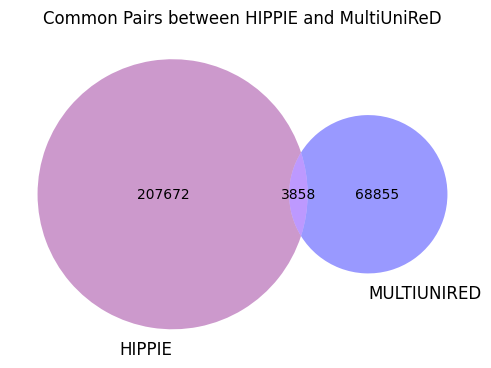

In [15]:
hippie_not_multiunired = (set(total_hippie_pairs).difference(set(total_multiunired_pairs)))
multiunired_not_hippie = (set(total_multiunired_pairs).difference(set(total_hippie_pairs))) #this is a list that contains gene pairs, each pair in a tuple format
hippie_and_multiunired = pairs_intersection(total_hippie_pairs, total_multiunired_pairs)
print ('\n HIPPIE NOT MULTIUNIRED:', len(hippie_not_multiunired))
print ('\n MULTIUNIRED NOT HIPPIE:', len(multiunired_not_hippie))
print ('\n HIPPIE AND MULTIUNIRED:', len(hippie_and_multiunired))

hippie_size = len(total_hippie_pairs)
multiunired_size = len(total_multiunired_pairs)
common = len(hippie_and_multiunired)

venn_diagram (subsets = (hippie_size, multiunired_size, common),
              set_labels = ('HIPPIE', 'MULTIUNIRED'),
              set_colors = ('purple', 'blue'),
              title = 'Common Pairs between HIPPIE and MultiUniReD')

In [ ]:
with open ('common_pairs.txt', 'w') as txtfile:
  for pair in hippie_and_multiunired:
    txtfile.write(f'{pair} \n')

###Scatter Plots

####MULTIUNIRED


 Total proteins with IDR content: (1423/1465)

 Total proteins without IDR content: (42/1465) 



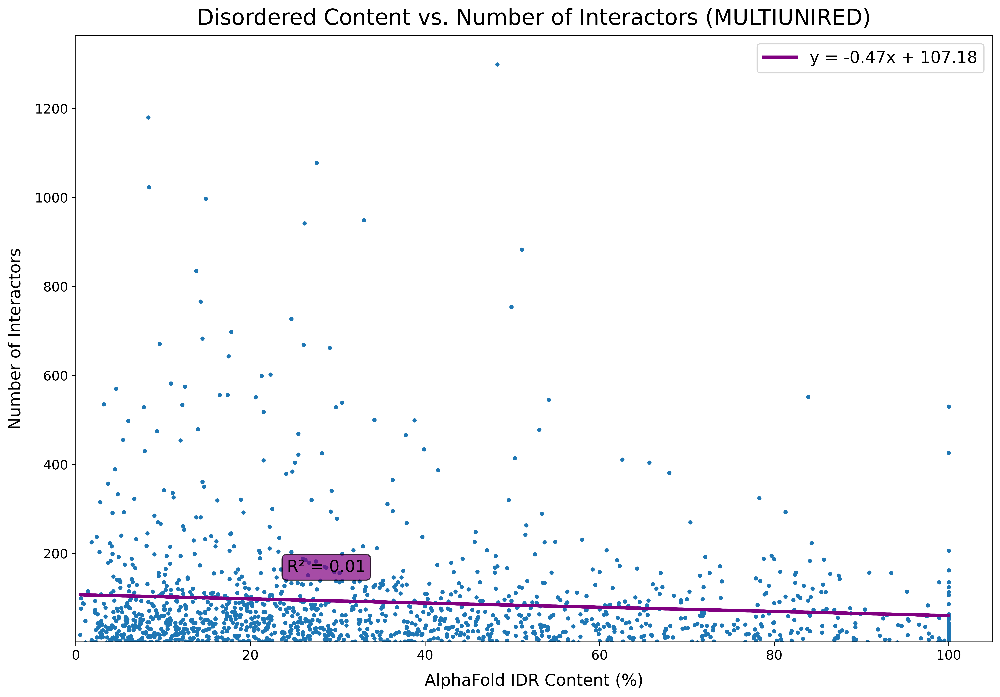

In [ ]:
#This graph shows the proteins that have idr content in relation to the number of interactors as found from MultiUniReD
x_axis = []
y_axis = []
count_none = 0
count_idrs = 0
no_idr_multi = []
# total = len(multiunired_mobidb_dict.keys())

for protein in total_mobidb_dict.keys():
  if 'MultiUniReD Protein Counts' in total_mobidb_dict[protein].keys():
    # protein_counts = total_mobidb_dict[protein]['Protein Counts']
    protein_counts = total_mobidb_dict[protein]['MultiUniReD Protein Counts']
    idr_content = total_mobidb_dict[protein]['Alphafold IDR Content']

    if idr_content != 0.0: # or idr_content != float
      x_axis.append(idr_content)
      y_axis.append((protein_counts))
      count_idrs +=1
    else:
      no_idr_multi.append(protein)
      count_none +=1
total = count_idrs + count_none

print ('\n Total proteins with IDR content: (%s/%s)' % (count_idrs, total))
print ('\n Total proteins without IDR content: (%s/%s) \n' % (count_none, total))
scatter_plot (x_axis, y_axis, 'AlphaFold IDR Content (%)', 'Number of Interactors', 'Disordered Content vs. Number of Interactors (MULTIUNIRED)', True)


 Total proteins with IDR content: (304/323)

 Total proteins without IDR content: (19/323) 



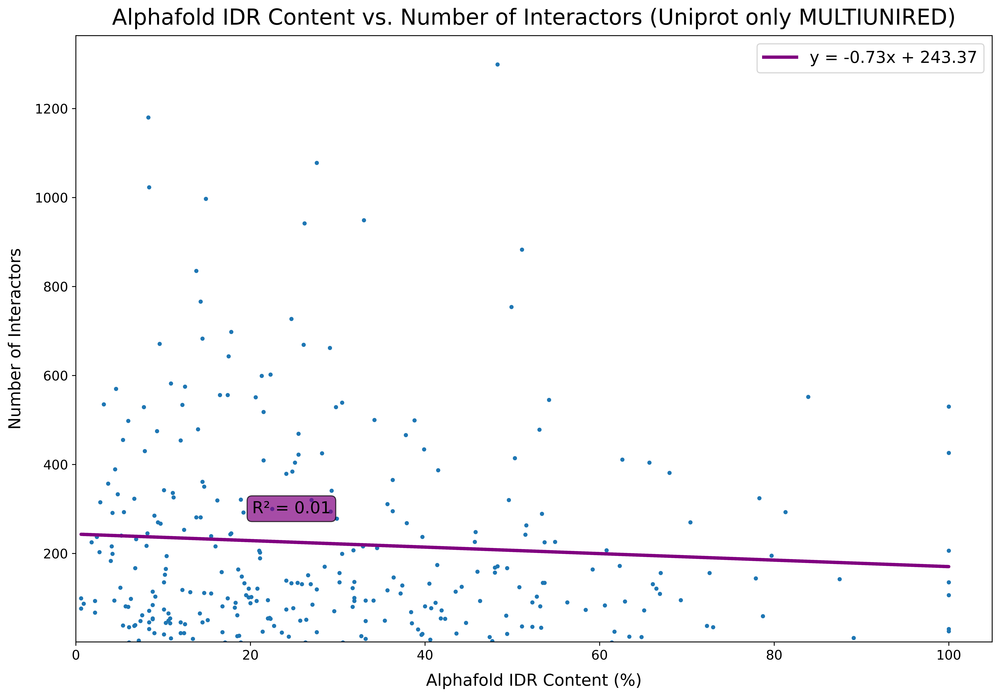

In [ ]:
#This graph shows the proteins that have idr content in relation to the number of interactors
x_axis = []
y_axis = []
count_none = 0
count_idrs = 0
no_idr_multi = []
# total = len(multiunired_mobidb_dict.keys())

for protein in total_mobidb_dict.keys():
  if 'MultiUniReD Protein Counts' in total_mobidb_dict[protein].keys() and protein in uniprot_ids:
    # protein_counts = total_mobidb_dict[protein]['Protein Counts']
    protein_counts = total_mobidb_dict[protein]['MultiUniReD Protein Counts']
    idr_content = total_mobidb_dict[protein]['Alphafold IDR Content']

    if idr_content != 0.0: # or idr_content != float
      x_axis.append(idr_content)
      y_axis.append((protein_counts))
      count_idrs +=1
    else:
      no_idr_multi.append(protein)
      count_none +=1
total = count_idrs + count_none

print ('\n Total proteins with IDR content: (%s/%s)' % (count_idrs, total))
print ('\n Total proteins without IDR content: (%s/%s) \n' % (count_none, total))
scatter_plot (x_axis, y_axis, 'Alphafold IDR Content (%)', 'Number of Interactors', 'Alphafold IDR Content vs. Number of Interactors (Uniprot only MULTIUNIRED)', True)

####HIPPIE


 Total proteins with IDR content: (1423/1465)

 Total proteins without IDR content: (42/1465) 



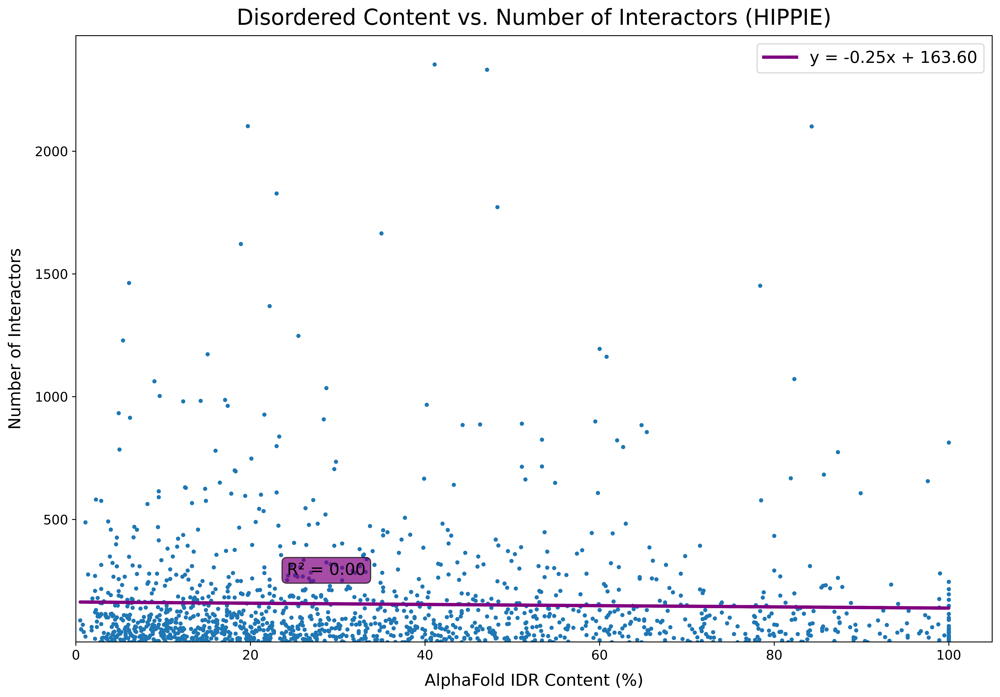

In [ ]:
#This graph shows the proteins that have idr content in relation to the number of interactors
x_axis = []
y_axis = []
count_none = 0
count_idrs = 0
no_idr_hippie = []
total = len(total_mobidb_dict)

for protein in total_mobidb_dict.keys():
  if 'HIPPIE Protein Counts' in total_mobidb_dict[protein].keys():
    # protein_counts = total_mobidb_dict[protein]['Protein Counts']
    protein_counts = total_mobidb_dict[protein]['HIPPIE Protein Counts']
    idr_content = total_mobidb_dict[protein]['Alphafold IDR Content']

    if idr_content != 0.0: # or idr_content != float
      x_axis.append(idr_content)
      y_axis.append((protein_counts))
      count_idrs +=1
    else:
      no_idr_hippie.append(protein)
      count_none +=1

# total = count_idrs + count_none

print ('\n Total proteins with IDR content: (%s/%s)' % (count_idrs, total))
print ('\n Total proteins without IDR content: (%s/%s) \n' % (count_none, total))

scatter_plot (x_axis, y_axis, 'AlphaFold IDR Content (%)', 'Number of Interactors', 'Disordered Content vs. Number of Interactors (HIPPIE)', True)

###MULTIUNIRED

####Histogram

In [ ]:
#the following code blocks splits the data from total_mobidb_dict into idrs and no idrs
idr_content_list = [] #a list with the idr percentage
idr_protein_counts_list = [] # a list with the number of interactors for each protein
idr_length_list = [] # a list whith the length of each protein with idr

no_idr_protein_counts_list = [] # a list with the number of interactors for each protein without idr
no_idr_length = [] # a list with the length of each protein with no idr
count_none = 0
count_idrs = 0
total = len(total_mobidb_dict.keys())

for protein in total_mobidb_dict.keys():
  if 'MultiUniReD Protein Counts' in total_mobidb_dict[protein].keys():
    protein_counts = total_mobidb_dict[protein]['MultiUniReD Protein Counts']
    idr_content = total_mobidb_dict[protein]['Alphafold IDR Content']
    length = total_mobidb_dict[protein]['Length']

    if idr_content != 0.0 : # or idr_content != float
      idr_content_list.append(idr_content)
      idr_protein_counts_list.append(protein_counts)
      idr_length_list.append(length)
      count_idrs +=1
    else:
      no_idr_protein_counts_list.append(protein_counts)
      no_idr_length.append(length)
      count_none +=1

print ('\n IDR content: (%s/%s)' % (count_idrs, total))
print ('\n No IDR content: (%s/%s) ' %  (count_none, total))
# print ('\n Total proteins with IDR content: (%s/%s)' % (count_idrs, total))



 IDR content: (1423/1465)

 No IDR content: (42/1465) 


####Average protein length of the proteins without IDR

In [ ]:
sum = 0
avg = 0.0
min_protein_length = float ('inf')
max_protein_length = float ('-inf')
for i in range (len(no_idr_length)):
  protein_len = no_idr_length[i]
  min_protein_length = min(protein_len, min_protein_length)
  max_protein_length = max(protein_len, max_protein_length)
  sum+= protein_len
print ('\n Min protein:', min_protein_length)
print ('\n Max protein:', max_protein_length)

if len(no_idr_length) != 0:
  avg = sum/len(no_idr_length)

print (f'\n Average: {avg:.2f}')


 Min protein: 85

 Max protein: 1097

 Average: 313.69


In [ ]:
with open ('min_max_ids_no_idr.txt', 'w') as file:

  for protein in total_mobidb_dict.keys():
    length = (total_mobidb_dict[protein]['Length'])
    if length == min_protein_length:
      file.write (f'\n Min protein: {protein}')
    elif length == max_protein_length:
      file.write (f'\n Max protein: {protein}')

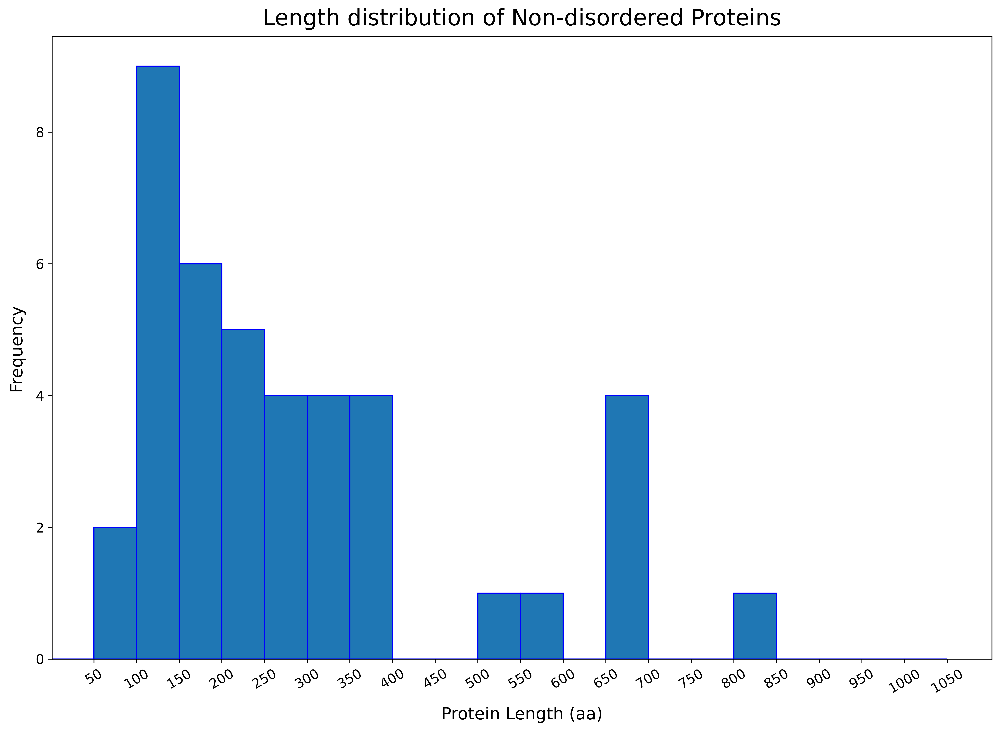

In [ ]:
#Histogram of the frequency of the protein lenghts

histogram (no_idr_length, (0, max_protein_length, 50), 'Protein Length (aa)', 'Frequency', 'Length distribution of Non-disordered Proteins')

####Average protein length of the proteins with IDR

In [ ]:
sum = 0
avg = 0.0
min_protein_length = float ('inf')
max_protein_length = float ('-inf')
for i in range (len(idr_length_list)):
  protein_len = idr_length_list[i]
  min_protein_length = min(protein_len, min_protein_length)
  max_protein_length = max(protein_len, max_protein_length)
  sum+= protein_len
print ('\n Min protein:', min_protein_length)
print ('\n Max protein:', max_protein_length)

if len(idr_length_list) != 0:
  avg = sum/len(idr_length_list)
print (f'\n Average: {avg:.2f}')


 Min protein: 24

 Max protein: 2647

 Average: 589.86


In [ ]:
with open ('min_max_ids_idr.txt', 'w') as file:

  for protein in total_mobidb_dict.keys():
    length = (total_mobidb_dict[protein]['Length'])
    if length == min_protein_length:
      file.write (f'\n Min protein: {protein}')
    elif length == max_protein_length:
      file.write (f'\n Max protein: {protein}')

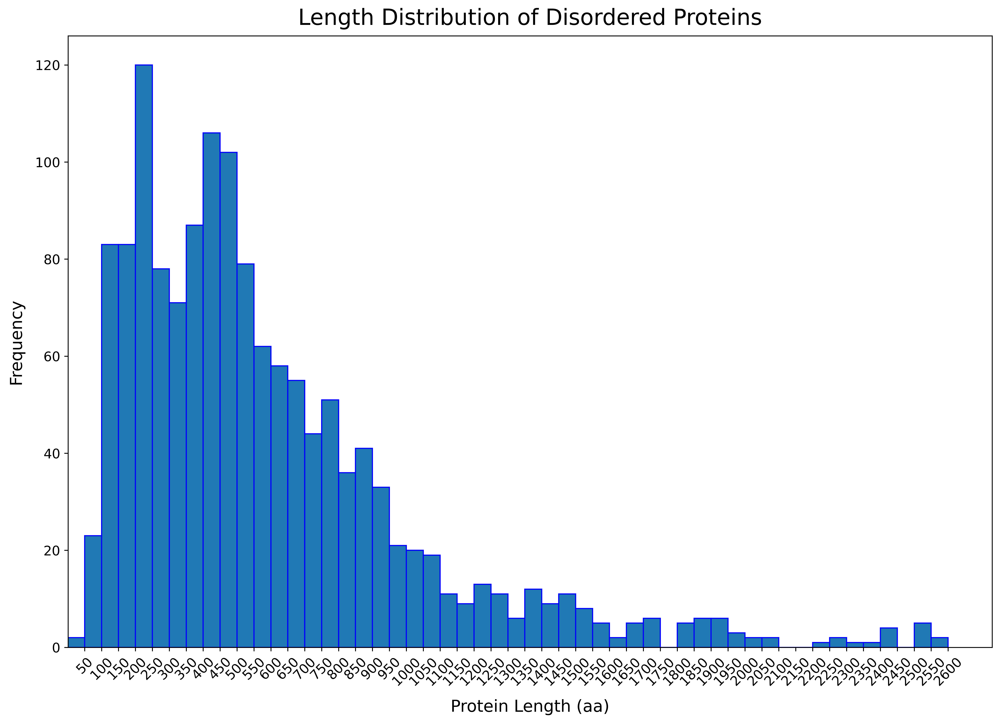

In [ ]:
#Histogram of the frequency of the protein lenghts

histogram (idr_length_list, (0, max_protein_length, 50), 'Protein Length (aa)', 'Frequency', 'Length Distribution of Disordered Proteins')


####Box Plot

#####MultiUniReD

In [ ]:
#The following code block calculates the average number of interactors of non-disordered or disordered
sum_idr = 0
sum_no_idr = 0
avg_idr = 0.0
avg_no_idr = 0.0
total_idr = 0
total_no_idr = 0
idr_counts = [] # a list with the number of interactors of each protein
no_idr_counts = [] # a list with the number of interactors of each protein


for protein in total_mobidb_dict.keys():
  # length = (total_mobidb_dict[protein]['Length'])
  protein_counts = total_mobidb_dict[protein]['MultiUniReD Protein Counts']
  idr_content = total_mobidb_dict[protein]['Alphafold IDR Content']

  if idr_content == 0.0:
    no_idr_counts.append(protein_counts)
    sum_no_idr+= protein_counts
    total_no_idr+=1

  else:
    idr_counts.append(protein_counts)
    sum_idr+= protein_counts
    total_idr+=1


if total_idr != 0:
  avg_idr = sum_idr/total_idr

print ('\n Total interactins: ', sum_idr)
print ('\n Total disordered proteins: ', total_idr)
print (f'\n Average idr: {avg_idr:.2f}')

if total_no_idr != 0:
  avg_no_idr = sum_no_idr/total_no_idr

print ('\n Total interactions: ', sum_no_idr)
print ('\n Total disordered proteins: ', total_no_idr)
print (f'\n Average no idr: {avg_no_idr:.2f}')


 Total interactins:  128023

 Total disordered proteins:  1423

 Average idr: 89.97

 Total interactions:  6246

 Total disordered proteins:  42

 Average no idr: 148.71


<ipython-input-92-023cf6d281fe>:4: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  bx = plt.boxplot([idr_counts, no_idr_counts], vert= True, labels = ['Disordered Proteins', 'Ordered Proteins'], showfliers = False, showmeans=True)


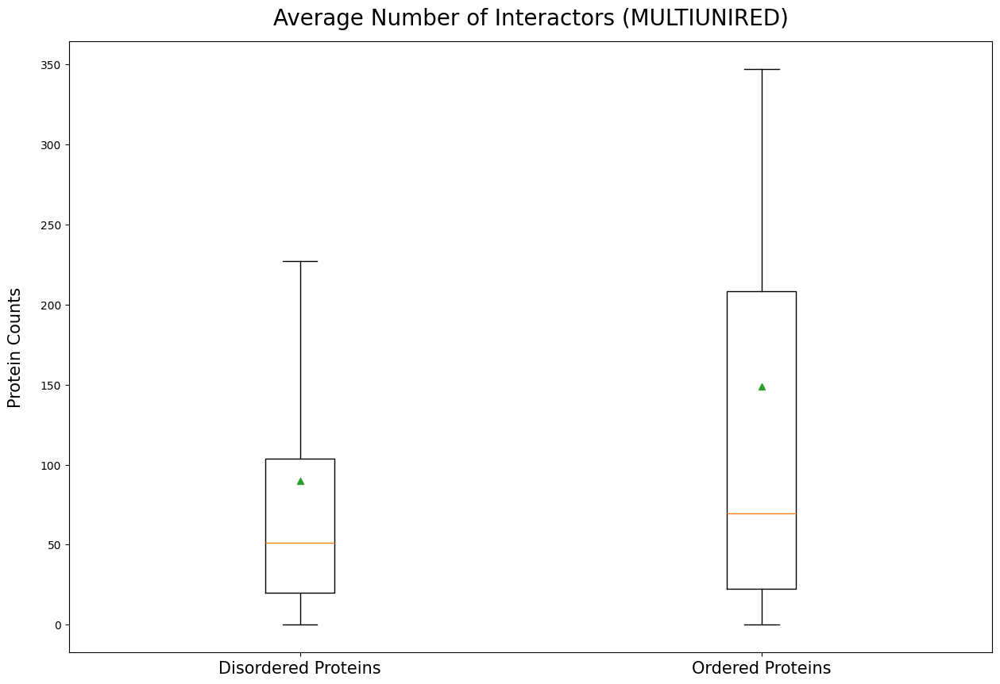

In [ ]:
#box plots for idr

plt.figure(figsize = (15,10))
bx = plt.boxplot([idr_counts, no_idr_counts], vert= True, labels = ['Disordered Proteins', 'Ordered Proteins'], showfliers = False, showmeans=True)

plt.xticks (fontsize = 15)
plt.ylabel ('Protein Counts', fontsize = 15, labelpad = 15)
plt.title ('Average Number of Interactors (MULTIUNIRED)', fontsize = 20, pad = 15)
plt.savefig('Average Number of Interactors (boxplot multi).png')
plt.show()

In [ ]:
# #I noticed that the majority of proteins have length between 100 and 250 aa so I wanted to count the average number of interactors
# sum_idr = 0
# sum_no_idr = 0
# avg_idr = 0.0
# avg_no_idr = 0.0
# total_idr = 0
# total_no_idr = 0
# idr_counts = []
# no_idr_counts = []

# for protein in total_mobidb_dict.keys():
#   length = (total_mobidb_dict[protein]['Length'])
#   protein_counts = total_mobidb_dict[protein]['MultiUniReD Protein Counts']
#   idr_content = total_mobidb_dict[protein]['Alphafold IDR Content']

#   if length in range (100,250):

#     if idr_content == 0.0:
#       no_idr_counts.append(protein_counts)
#       sum_no_idr+= protein_counts
#       total_no_idr+=1

#     else:
#       idr_counts.append(protein_counts)
#       sum_idr+= protein_counts
#       total_idr+=1



# avg_idr = sum_idr/total_idr
# print (sum_idr)
# print (total_idr)
# print (f'\n Average idr: {avg_idr:.2f}')
# avg_no_idr = sum_no_idr/total_no_idr
# print (sum_no_idr)
# print (total_no_idr)
# print (f'\n Average no idr: {avg_no_idr:.2f}')

22924
286

 Average idr: 80.15
3884
20

 Average no idr: 194.20


In [ ]:
mann_whitney_test (idr_counts, no_idr_counts)


 Mann-Whitney U Test

 p-value: 0.00

 statistic: 535257.5


####Scatter Plot (Length Vs Number of interactors)

#####Proteins with IDR

In [ ]:
print (idr_protein_counts_list)
print (idr_length_list)

[0, 24, 44, 0, 139, 167, 28, 315, 20, 1, 133, 54, 1, 114, 225, 14, 291, 183, 123, 114, 32, 48, 320, 91, 81, 835, 83, 119, 93, 28, 172, 206, 6, 217, 545, 88, 88, 103, 80, 268, 99, 0, 454, 37, 144, 498, 14, 68, 113, 754, 260, 23, 156, 223, 156, 52, 53, 132, 109, 34, 63, 207, 135, 61, 129, 157, 22, 1299, 91, 535, 49, 430, 87, 0, 643, 529, 37, 766, 152, 575, 187, 602, 1, 949, 727, 123, 40, 12, 37, 11, 71, 185, 1078, 162, 683, 19, 455, 59, 81, 107, 85, 142, 295, 74, 997, 409, 105, 46, 499, 129, 100, 29, 84, 518, 34, 67, 52, 17, 552, 19, 293, 115, 365, 5, 60, 27, 0, 44, 8, 115, 118, 1023, 51, 91, 155, 95, 58, 89, 127, 100, 43, 2, 127, 81, 179, 154, 73, 183, 85, 570, 1180, 245, 323, 4, 150, 186, 239, 9, 3, 52, 341, 23, 232, 76, 94, 1, 132, 556, 336, 30, 113, 64, 41, 8, 12, 146, 70, 32, 156, 422, 39, 237, 293, 671, 171, 0, 5, 361, 270, 10, 63, 3, 534, 65, 46, 20, 81, 101, 41, 357, 83, 425, 194, 52, 76, 0, 182, 91, 17, 158, 13, 142, 530, 350, 669, 311, 245, 49, 146, 285, 65, 883, 114, 5, 55, 12

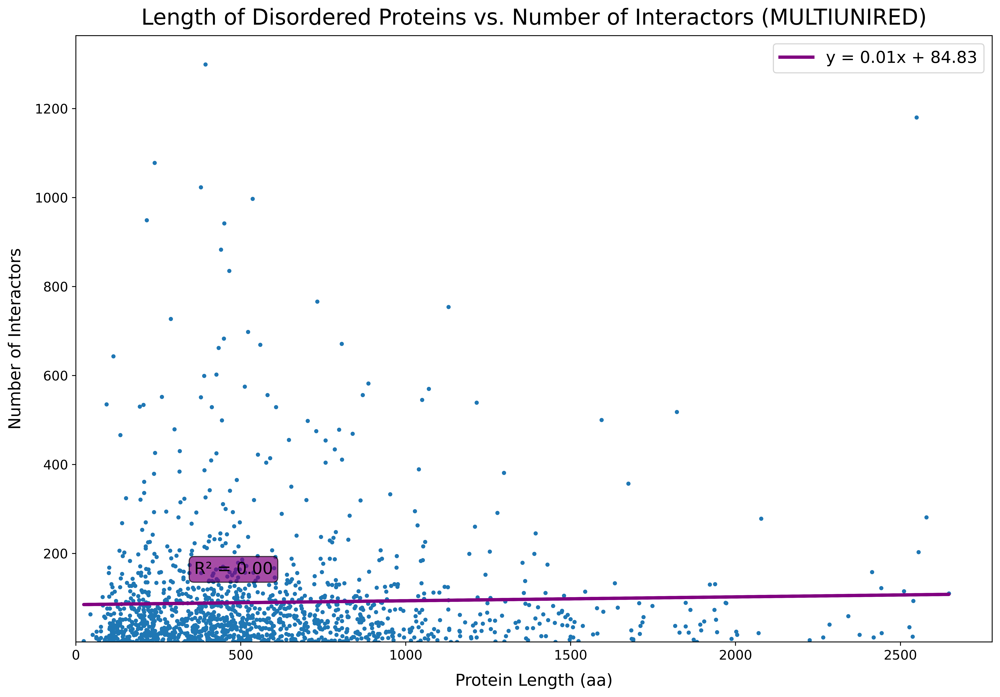

In [ ]:
x_axis = idr_length_list
y_axis = idr_protein_counts_list
# for count in idr_protein_counts_list:
#   y_axis.append(log(count)) # its risky because if it comes with 0 values it will print a math error

scatter_plot (x_axis, y_axis, 'Protein Length (aa)', 'Number of Interactors', 'Length of Disordered Proteins vs. Number of Interactors (MULTIUNIRED)', True)

In [ ]:
#Mann Whitney test

mann_whitney_test (x_axis, y_axis)


 Mann-Whitney U Test

 p-value: 0.00

 statistic: 1926431.5


#####Proteins without IDR

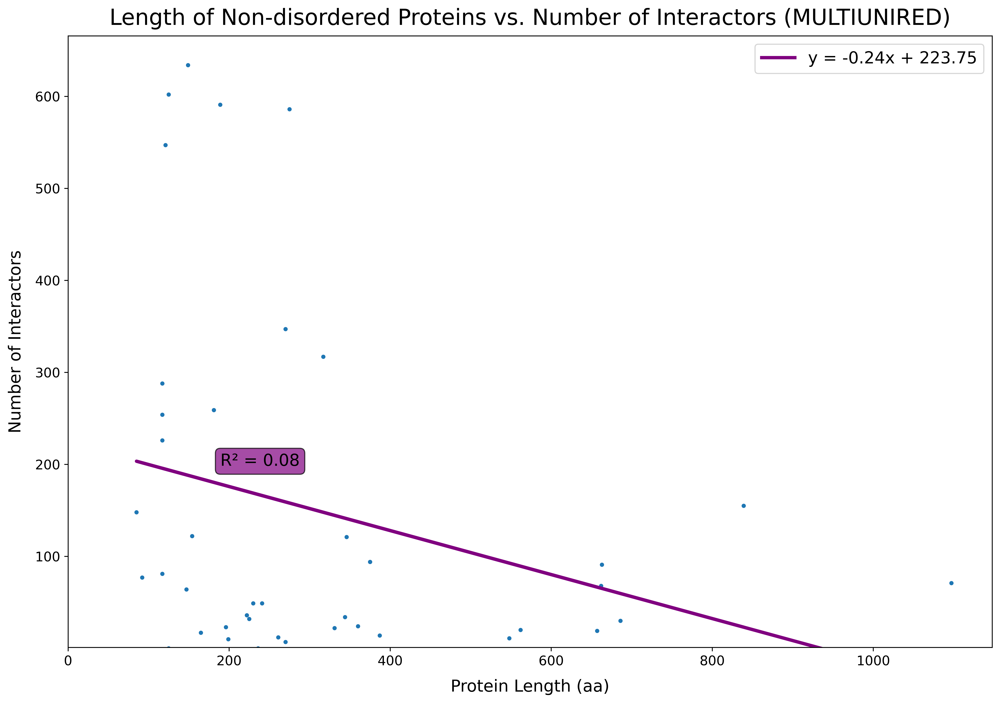

In [ ]:
x_axis = no_idr_length
y_axis = no_idr_protein_counts_list
# y_axis = []
# for count in no_idr_protein_counts_list:
#   y_axis.append(log(count)) # math error

scatter_plot (x_axis, y_axis, 'Protein Length (aa)', 'Number of Interactors', 'Length of Non-disordered Proteins vs. Number of Interactors (MULTIUNIRED)', True)

In [ ]:
#Mann Whitney

mann_whitney_test (x_axis, y_axis)


 Mann-Whitney U Test

 p-value: 0.00

 statistic: 1400.0


###HIPPIE

####Box Plot

In [ ]:
#I noticed that the majority of proteins have length between 200 and 400 aa so I wanted to count the average number of interactors
sum_idr = 0
sum_no_idr = 0
avg_idr = 0.0
avg_no_idr = 0.0
total_idr = 0
total_no_idr = 0
idr_counts = []
no_idr_counts = []


for protein in total_mobidb_dict.keys():
  # length = (total_mobidb_dict[protein]['Length'])
  protein_counts = total_mobidb_dict[protein]['HIPPIE Protein Counts']
  idr_content = total_mobidb_dict[protein]['Alphafold IDR Content']

  # if length in range (200,401):

  if idr_content == 0.0:
    no_idr_counts.append(protein_counts)
    sum_no_idr+= protein_counts
    total_no_idr+=1

  else:
    idr_counts.append(protein_counts)
    sum_idr+= protein_counts
    total_idr+=1


if total_idr != 0:
  avg_idr = sum_idr/total_idr

print ('\n Total number of interactions: ', sum_idr)
print ('\n Total disordered proteins: ', total_idr)
print (f'\n Average idr: {avg_idr:.2f}')

if total_no_idr != 0:
  avg_no_idr = sum_no_idr/total_no_idr

print ('\n Total number of interactions: ', sum_no_idr)
print ('\n Total disordered proteins: ', total_no_idr)
print (f'\n Average no idr: {avg_no_idr:.2f}')


 Total number of interactions:  219868

 Total disordered proteins:  1423

 Average idr: 154.51

 Total number of interactions:  6744

 Total disordered proteins:  42

 Average no idr: 160.57


<ipython-input-99-4f5c51f8d352>:4: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  bx = plt.boxplot([idr_counts, no_idr_counts], vert= True, labels = ['Disordered Proteins', 'Ordered Proteins'] , showfliers = False, showmeans=True)


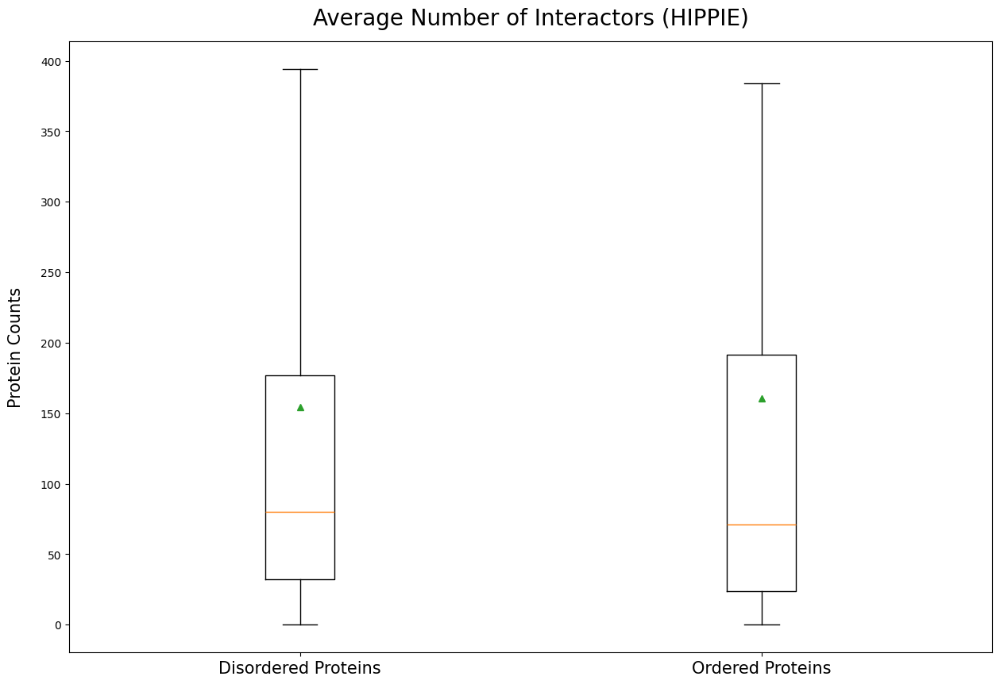

In [ ]:
#box plots for idr

plt.figure(figsize = (15,10))
bx = plt.boxplot([idr_counts, no_idr_counts], vert= True, labels = ['Disordered Proteins', 'Ordered Proteins'] , showfliers = False, showmeans=True)
plt.xticks (fontsize = 15)
plt.ylabel ('Protein Counts', fontsize = 15, labelpad = 15)
plt.title ('Average Number of Interactors (HIPPIE)', fontsize = 20, pad = 15)
plt.savefig('Average Number of Interactors (boxplot hippie).png')
plt.show()

In [ ]:
mann_whitney_test (idr_counts, no_idr_counts)


 Mann-Whitney U Test

 p-value: 0.00

 statistic: 1400.0


####Scatter Plot (Length Vs Number of interactors)

#####Proteins with IDR

In [ ]:
print (idr_protein_counts_list)
print (idr_length_list)

[0, 24, 44, 0, 139, 167, 28, 315, 20, 1, 133, 54, 1, 114, 225, 14, 291, 183, 123, 114, 32, 48, 320, 91, 81, 835, 83, 119, 93, 28, 172, 206, 6, 217, 545, 88, 88, 103, 80, 268, 99, 0, 454, 37, 144, 498, 14, 68, 113, 754, 260, 23, 156, 223, 156, 52, 53, 132, 109, 34, 63, 207, 135, 61, 129, 157, 22, 1299, 91, 535, 49, 430, 87, 0, 643, 529, 37, 766, 152, 575, 187, 602, 1, 949, 727, 123, 40, 12, 37, 11, 71, 185, 1078, 162, 683, 19, 455, 59, 81, 107, 85, 142, 295, 74, 997, 409, 105, 46, 499, 129, 100, 29, 84, 518, 34, 67, 52, 17, 552, 19, 293, 115, 365, 5, 60, 27, 0, 44, 8, 115, 118, 1023, 51, 91, 155, 95, 58, 89, 127, 100, 43, 2, 127, 81, 179, 154, 73, 183, 85, 570, 1180, 245, 323, 4, 150, 186, 239, 9, 3, 52, 341, 23, 232, 76, 94, 1, 132, 556, 336, 30, 113, 64, 41, 8, 12, 146, 70, 32, 156, 422, 39, 237, 293, 671, 171, 0, 5, 361, 270, 10, 63, 3, 534, 65, 46, 20, 81, 101, 41, 357, 83, 425, 194, 52, 76, 0, 182, 91, 17, 158, 13, 142, 530, 350, 669, 311, 245, 49, 146, 285, 65, 883, 114, 5, 55, 12

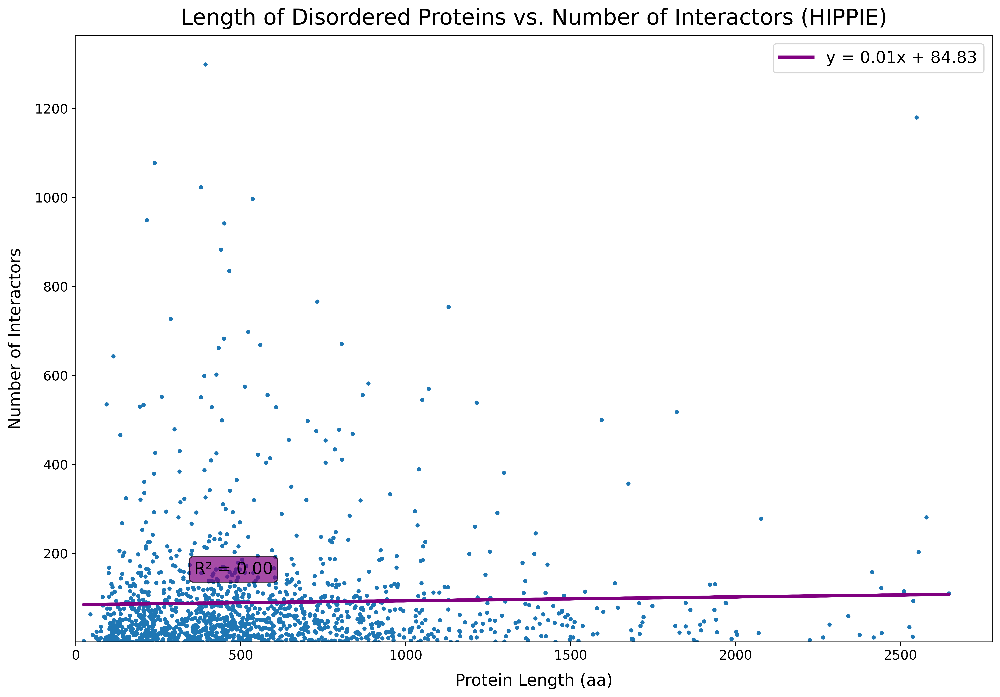

In [ ]:
x_axis = idr_length_list
y_axis = idr_protein_counts_list
# for count in idr_protein_counts_list:
#   y_axis.append(log(count)) # its risky because if it comes with 0 values it will print a math error

scatter_plot (x_axis, y_axis, 'Protein Length (aa)', 'Number of Interactors', 'Length of Disordered Proteins vs. Number of Interactors (HIPPIE)', True)

In [ ]:
#Mann Whitney test

mann_whitney_test (x_axis, y_axis)


 Mann-Whitney U Test

 p-value: 0.00

 statistic: 1926431.5


#####Proteins without IDR

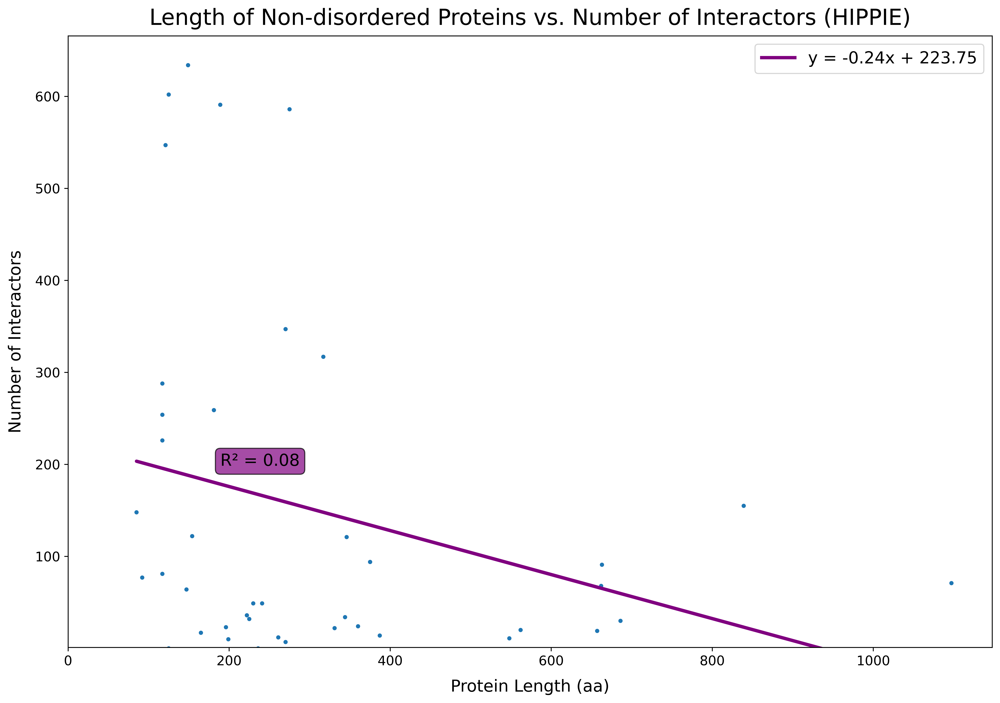

In [ ]:
x_axis = no_idr_length
y_axis = no_idr_protein_counts_list
# y_axis = []
# for count in no_idr_protein_counts_list:
#   y_axis.append(log(count)) # math error

scatter_plot (x_axis, y_axis, 'Protein Length (aa)', 'Number of Interactors', 'Length of Non-disordered Proteins vs. Number of Interactors (HIPPIE)', True)

In [ ]:
ratio_disordered = []
ratio_ordered = []

for protein in total_mobidb_dict.keys():

  length = (total_mobidb_dict[protein]['Length'])
  protein_counts = total_mobidb_dict[protein]['HIPPIE Protein Counts']
  idr_content = total_mobidb_dict[protein]['Alphafold IDR Content']


  if idr_content != 0.0:
    ratio = idr_content/length
    ratio_disordered.append(float(f'{ratio:.2f}'))

print (ratio_disordered)



[0.08, 0.17, 0.04, 0.02, 0.06, 0.02, 0.05, 0.01, 0.09, 0.29, 0.01, 0.03, 0.04, 0.21, 0.07, 0.02, 0.0, 0.0, 0.01, 0.09, 0.08, 0.01, 0.05, 0.07, 0.24, 0.03, 1.19, 0.07, 0.09, 0.79, 0.12, 0.07, 1.06, 0.02, 0.05, 0.04, 0.09, 0.1, 0.51, 0.27, 0.02, 0.03, 0.02, 0.2, 0.57, 0.01, 0.04, 0.15, 0.5, 0.04, 0.02, 0.0, 0.25, 0.19, 0.05, 0.66, 0.05, 0.2, 0.06, 0.33, 0.0, 0.08, 0.06, 0.01, 0.08, 0.22, 0.3, 0.12, 0.03, 0.03, 0.01, 0.03, 0.06, 0.0, 0.15, 0.02, 0.23, 0.02, 0.02, 0.02, 0.1, 0.05, 0.15, 0.15, 0.09, 0.14, 0.33, 0.01, 0.27, 0.32, 0.01, 0.07, 0.12, 0.32, 0.03, 0.11, 0.01, 0.06, 0.06, 0.03, 0.04, 0.04, 0.04, 0.51, 0.03, 0.05, 0.01, 0.04, 0.09, 0.08, 0.11, 0.03, 0.02, 0.01, 0.06, 0.0, 0.75, 0.93, 0.32, 0.34, 0.17, 0.07, 0.07, 0.14, 0.61, 0.32, 1.39, 0.18, 0.09, 0.04, 0.1, 0.02, 0.02, 0.05, 0.04, 0.07, 0.91, 0.08, 0.02, 0.01, 0.08, 0.08, 0.49, 0.07, 0.05, 0.62, 0.04, 0.51, 0.13, 0.0, 0.0, 0.01, 0.02, 0.16, 0.44, 0.17, 0.04, 1.56, 0.05, 0.01, 0.06, 0.13, 0.04, 0.25, 0.27, 0.03, 0.06, 0.02, 0.05, 

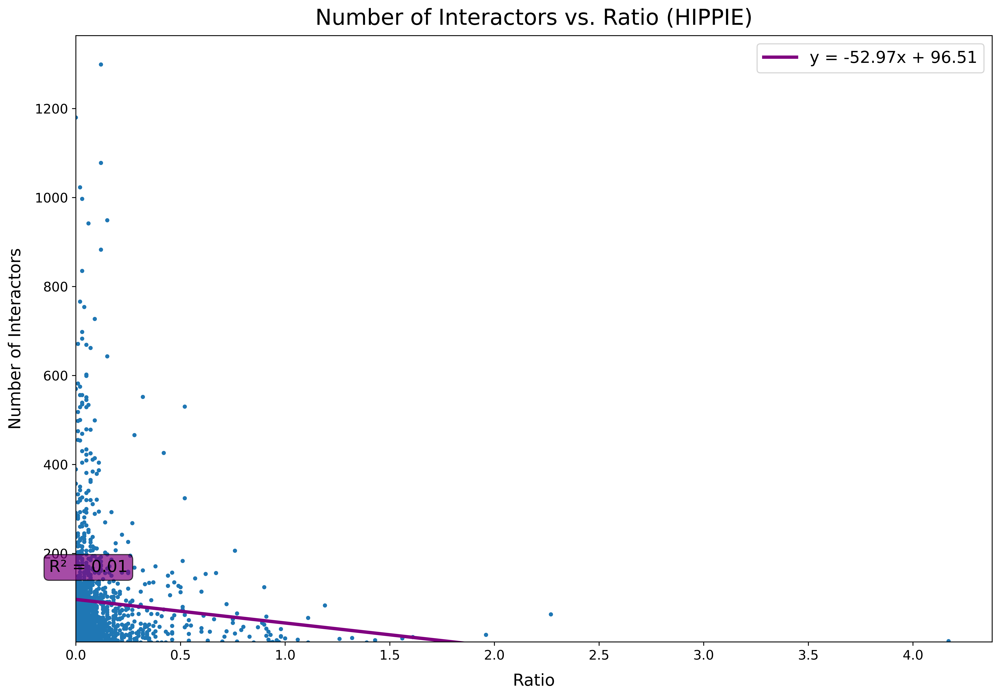

In [ ]:
x_axis = ratio_disordered
y_axis = idr_protein_counts_list

scatter_plot (x_axis, y_axis, 'Ratio', 'Number of Interactors', 'Number of Interactors vs. Ratio (HIPPIE)', True)

In [ ]:
#Mann Whitney

mann_whitney_test (x_axis, y_axis)


 Mann-Whitney U Test

 p-value: 0.00

 statistic: 1400.0


In [ ]:
!zip 'Graphs.zip' *.png

  adding: Alphafold IDR Content vs. Number of Interactors (Uniprot only MULTIUNIRED).png (deflated 39%)
  adding: Average Number of Interactors (boxplot hippie).png (deflated 30%)
  adding: Average Number of Interactors (boxplot multi).png (deflated 29%)
  adding: Common Pairs between HIPPIE and MultiUniReD.png (deflated 9%)
  adding: Disordered Content vs. Number of Interactors (HIPPIE).png (deflated 34%)
  adding: Disordered Content vs. Number of Interactors (MULTIUNIRED).png (deflated 33%)
  adding: Length Distribution of Disordered Proteins.png (deflated 43%)
  adding: Length distribution of Non-disordered Proteins.png (deflated 49%)
  adding: Length of Disordered Proteins vs. Number of Interactors (HIPPIE).png (deflated 35%)
  adding: Length of Disordered Proteins vs. Number of Interactors (MULTIUNIRED).png (deflated 34%)
  adding: Length of Non-disordered Proteins vs. Number of Interactors (HIPPIE).png (deflated 42%)
  adding: Length of Non-disordered Proteins vs. Number of Inter

In [ ]:
pair_1 = [('A', 'B'), ('C', 'D'), ('E', 'F')]
pair_2 = [('A', 'C'), ('F', 'E')]

print (pairs_intersection(pair_1, pair_2))

Common non-reversed pairs : 0
[]
Common reversed pairs: 1
[('E', 'F')]
Total common pairs: 1
[('E', 'F')]
{('E', 'F')}


#Network generation - Case Studies

In [31]:
#load the protein and gene names
!wget https://raw.githubusercontent.com/evasiliou/BIO491/refs/heads/main/Protein%20and%20Gene%20Names%20all%20the%20dataset/Protein%20and%20Gene%20names.csv
!wget https://raw.githubusercontent.com/evasiliou/BIO491/refs/heads/main/Protein%20and%20Gene%20Names%20all%20the%20dataset/not_found_associated_genes.txt

--2025-04-05 14:21:11--  https://raw.githubusercontent.com/evasiliou/BIO491/refs/heads/main/Protein%20and%20Gene%20Names%20all%20the%20dataset/Protein%20and%20Gene%20names.csv
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.109.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 711174 (695K) [text/plain]
Saving to: ‘Protein and Gene names.csv’

Protein and Gene na 100%[===================>] 694.51K  --.-KB/s    in 0.05s   

2025-04-05 14:21:11 (12.4 MB/s) - ‘Protein and Gene names.csv’ saved [711174/711174]

--2025-04-05 14:21:11--  https://raw.githubusercontent.com/evasiliou/BIO491/refs/heads/main/Protein%20and%20Gene%20Names%20all%20the%20dataset/not_found_associated_genes.txt
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.109.133, 185.199.110.133, ...
Connecting to

In [32]:
df = pd.read_csv ('Protein and Gene names.csv')

proteins_to_genes_dict = {} #create a dictionary that has as keys the UniProt acc and as values the equivalent gene name

for i in range (len(df)):
  protein = df['UniProt Acc'][i]
  gene = df['Gene Name'][i]
  protein_name = df['Protein Name'][i]
  proteins_to_genes_dict[protein] = {'Gene': gene, 'Protein Name': protein_name}


print (len(proteins_to_genes_dict))
print (proteins_to_genes_dict)

15000
{'P21675': {'Gene': 'TAF1', 'Protein Name': 'Transcription initiation factor TFIID subunit 1'}, 'P20226': {'Gene': 'TBP', 'Protein Name': 'TATA-box-binding protein'}, 'P55072': {'Gene': 'VCP', 'Protein Name': 'Transitional endoplasmic reticulum ATPase'}, 'Q13153': {'Gene': 'PAK1', 'Protein Name': 'Serine/threonine-protein kinase PAK 1'}, 'Q14155': {'Gene': 'ARHGEF7', 'Protein Name': 'Rho guanine nucleotide exchange factor 7'}, 'P63000': {'Gene': 'RAC1', 'Protein Name': 'Ras-related C3 botulinum toxin substrate 1'}, 'P54252': {'Gene': 'ATXN3', 'Protein Name': 'Ataxin-3'}, 'Q9BRT9': {'Gene': 'GINS4', 'Protein Name': 'DNA replication complex GINS protein SLD5'}, 'Q14691': {'Gene': 'GINS1', 'Protein Name': 'DNA replication complex GINS protein PSF1'}, 'Q07820': {'Gene': 'MCL1', 'Protein Name': 'Induced myeloid leukemia cell differentiation protein Mcl-1'}, 'O43521': {'Gene': 'BCL2L11', 'Protein Name': 'Bcl-2-like protein 11'}, 'P40763': {'Gene': 'STAT3', 'Protein Name': 'Signal trans

In [33]:
def network_nodes (query_list, interactions_pairs, input_type, filename):
  '''
  The aim of this function is to find the interactions from the protein pairs of the given proteins. In case that the query_list contains genes then they will be converted to their protein accession as all the pairs are recorded with their protein accession. After finding the interactors, they will be converted to their gene names, for readability on networks.

  query_list: a list with the gene names or uniprot acc of which we want ot fine the interactos and create the network interactions_pairs: a list with tuples that represnt the pairs of proteins that interact with each other, ually HIPPIE or MulitUniReD (if both then they have to be merged)
  input_type: this is a string 'gene' or 'protein'
  filename: the name of the file with the protein pairs in .csv format
  '''

  #in the case that the query_list contains gene names, i have to convert them to the protein accession because the interactions are recordered in this form
  if input_type == 'gene':
    new_query_list = [] #creates an empty list to save the protein names
    genes_to_proteins_dict = {} #create a new reversed dictionary that has as keys the gene names and as values the protein names
    genes_to_proteins_dict = dict(zip(proteins_to_genes_dict.values(), proteins_to_genes_dict.keys())) #create the reversed dictionary from the one that that was initially created, having as keys the gene names and as values the uniprot acc

    for gene in query_list:
      if gene in genes_to_proteins_dict.keys():
        protein = genes_to_proteins_dict[gene]
        if protein !='None':
          new_query_list.append(protein)
        else:
          print (f'\n The gene {gene} has not been found')

    query_list = new_query_list #now the query list contains the equivalent uniprot acc of the genes initially provided and the PPIN can be created
    print (query_list)

  interactors_A_genes_list = [] # saves the interactors in a list to create the csv file
  interactors_B_genes_list = [] # saves the interactors in a list to create the csv file
  uniprot_name_a_list = []
  uniprot_name_b_list = []

  #With the following two lists I prepare the data as edges and nodes if I want to use another function to create the networks programmatically
  gene_pairs = [] # create a list with the pairs that were found but to have their gene names for better visualization when creating the networks
  gene_interactors = [] # a list that contains all the interactors only once, they are the nodes


  #At this point i search for the interactors of the proteins of the query list and append in lists the equivalent gene names and protein names
  for pair in interactions_pairs:
    interactor_a = pair[0]
    interactor_b = pair[1]

    for protein in query_list:
      if interactor_a == protein or interactor_b == protein:
        gene_a = proteins_to_genes_dict[interactor_a]['Gene']
        gene_b = proteins_to_genes_dict[interactor_b]['Gene']

        if gene_a != 'None' and gene_b != 'None':
          interactors_A_genes_list.append(gene_a)
          interactors_B_genes_list.append(gene_b)

          pair = (gene_a, gene_b)

          if pair not in gene_pairs:
            gene_pairs.append(pair)

          if gene_a not in gene_interactors:
            gene_interactors.append(gene_a)
          if gene_b not in gene_interactors:
            gene_interactors.append(gene_b)

          uniprot_name_dict = uniprot_query([interactor_a, interactor_b], ['protein_name'])
          uniprot_name_a = uniprot_name_dict[interactor_a]['Protein Name']
          uniprot_name_b = uniprot_name_dict[interactor_b]['Protein Name']


          if interactor_a in uniprot_name_dict.keys():
            uniprot_name_a = proteins_to_genes_dict[interactor_a]['Protein Name'] #find the Protein Name from the dictionary that was created above
          else:
            uniprot_name_dict = uniprot_query([interactor_a], ['protein_name']) #if the protein name is not in the file 'Protein and Gene names.csv' we make a query in uniprot via the uniprot_query function
            uniprot_name_a = uniprot_name_dict[interactor_a]['Protein Name']

          if interactor_b in uniprot_name_dict.keys():
            uniprot_name_b = proteins_to_genes_dict[interactor_b]['Protein Name'] #find the Protein Name from the dictionary that was created above

          else:
            uniprot_name_dict = uniprot_query([interactor_b], ['protein_name']) #if the protein name is not in the file 'Protein and Gene names.csv' we make a query in uniprot via the uniprot_query function
            uniprot_name_a = uniprot_name_dict[interactor_b]['Protein Name']


          uniprot_name_a_list.append(uniprot_name_a)
          uniprot_name_b_list.append(uniprot_name_b)

  print (len(interactors_A_genes_list))
  print (len(interactors_B_genes_list))
  print (len(uniprot_name_a_list))
  print (len(uniprot_name_b_list))


  new_csv_file(column_labels = ['Interactor A', 'Interactor B', 'Protein Name A', 'Protein Name B'], column_data = [interactors_A_genes_list, interactors_B_genes_list, uniprot_name_a_list, uniprot_name_b_list ], filename = filename, index_status = False)

  return (gene_interactors, gene_pairs)

##Common Pairs between HIPPIE and MultiUniReD

In [19]:
common_pairs = hippie_and_multiunired
print (len(common_pairs))

3858


In [ ]:
#  if ('Q14061','P04637') in common_pairs:
#     print('aloha')
c=0
for pair in common_pairs:
  if pair[0]==pair[1]:
    c+=1#print (pair)
c


l1 = [('a','b'), ('c','d'), ('d','a'),('b','g'),('e','f'),('d','d') ]
l2 = [('b','a'), ('d','d'), ('d','c')]

s1=set(l1)
s2=set(l2)
r2=[]
for pair in s2:
  r2.append((pair[1],pair[0]))
sr2=set(r2)


print (s1.intersection(s2))

print (s1.intersection(s2.union(sr2)))

{('d', 'd')}
{('c', 'd'), ('d', 'd'), ('a', 'b')}


In [ ]:
common_pairs_list = []
for pair in common_pairs:

  reverse_pair = tuple(reversed(pair))

  if reverse_pair in common_pairs:
    common_pairs_list.append(pair)

print (len(common_pairs_list))
print (common_pairs_list)

In [ ]:
with open ('common_pairs.txt', 'w') as txtfile:
  for pair in common_pairs:
    txtfile.write (f'{pair} \n')

In [21]:
all_proteins = set(disprot_ids).union(set(uniprot_ids))
print (len(all_proteins))

1542


In [ ]:
common_nodes, common_edges = network_nodes (all_proteins, common_pairs, 'protein','common_interactors_hippie_multiunired.csv', )
print (len(common_nodes))
print (common_nodes)
print (len(common_edges))
print (common_edges)

In [ ]:
protein_name_list = []
description_list = []
disordered_list = []
protein_counts_hippie_list = []
protein_counts_multi_list = []

for protein in common_nodes:
  protein_name = proteins_to_genes_dict[protein]['Protein Name']

  protein_name_list.append(protein_name)

  if protein in total_mobidb_dict.keys():
    disordered = total_mobidb_dict[protein]['Alphafold IDR Content']
    protein_counts_hippie = total_mobidb_dict[protein]['HIPPIE Protein Counts']
    protein_counts_multi = total_mobidb_dict[protein]['MultiUniReD Protein Counts']

  else:
    disordered = 'N/A'
    protein_counts_hippie = 'N/A'
    protein_counts_multi = 'N/A'

  disordered_list.append(disordered)
  protein_counts_hippie_list.append(protein_counts_hippie)
  protein_counts_multi_list.append(protein_counts_multi)



new_csv_file(column_labels = ['UniProt Acc', 'Protein Name', 'AlphaFold Disordered', 'Protein Counts HIPPIE', 'Protein Counts MultiUniReD' 'Function'],
             column_data = [common_nodes, protein_name_list, disordered_list, protein_counts_hippie, protein_counts_multi, description_list],
             filename = 'common_interactors_description.csv', index_status = True)

##Fully Disordered Proteins (100%)

In [ ]:
disordered_proteins = []
uniprot_name_list = []
multi_counts_list = []
hippie_counts_list = []
filename = 'fully_disordered_proteins.csv'
for protein in total_mobidb_dict.keys():
  # print (protein)
  idr_percentage = total_mobidb_dict[protein]['Alphafold IDR Content']
  multi_counts = total_mobidb_dict[protein]['MultiUniReD Protein Counts']
  hippie_counts = total_mobidb_dict[protein]['HIPPIE Protein Counts']

  if idr_percentage == 100.0:

    uniprot_name = proteins_to_genes_dict[protein]['Protein Name']

    disordered_proteins.append(protein)
    uniprot_name_list.append(uniprot_name)
    multi_counts_list.append(multi_counts)
    hippie_counts_list.append(hippie_counts)

new_csv_file(column_labels = ['Protein Accession', 'Protein Name', 'MultiUniReD Protein Counts', 'HIPPIE Protein Counts'], column_data = [disordered_proteins, uniprot_name_list, multi_counts_list, hippie_counts_list], filename = filename, index_status = True)

###Thymosin beta4 HIPPIE

In [ ]:
tsv_file = 'autophagosome_proteins.tsv'
df = pd.read_table(tsv_file, sep ='\t')
autophagosome_proteins = list(df['Entry'])
print (autophagosome_proteins)
print (len(autophagosome_proteins))

In [ ]:
#find the gene names and the protein name of proteins that are invomved in the autophagosome
protein_to_gene_conversion_dict = protein_to_gene_conversion(autophagosome_proteins)
uniprot_name_dict = uniprot_query(autophagosome_proteins, ['protein_name'])

for protein in autophagosome_proteins:
  gene = protein_to_gene_conversion_dict[protein]
  protein_name = uniprot_name_dict
  proteins_to_genes_dict.update({protein: {'Gene': gene, 'Protein Name': protein_name}})

In [ ]:
#find the interactors of thymosin
thymosin_interactors_dict = protein_interactors_counter(['P62328'], total_hippie_pairs)

thymosin_interactors = thymosin_interactors_dict['P62328'] + ['P62328']
print (thymosin_interactors)


 Total interactors:  1

 Proteins with no interactors:  0

 The file not_interacting_proteins_1.txt has been saved!

 The file interacting_proteins_1.csv has been saved!
['P04637', 'P20073', 'P38936', 'P63261', 'P40692', 'P68133', 'Q15323', 'P13533', 'Q8TF50', 'Q03933', 'Q03135', 'P12004', 'P60510', 'P51693', 'O75031', 'O60216', 'Q13432', 'Q9ULX6', 'P68104', 'P35226', 'P13646', 'Q5UIP0', 'Q13643', 'P13196', 'Q04724', 'Q8IUC2', 'Q8WWQ8', 'O00468', 'P36406', 'O76013', 'Q14451', 'P31943', 'P19012', 'Q93062', 'Q9BPY3', 'Q8WX94', 'P14373', 'Q6A162', 'Q8TAS1', 'Q9H5J8', 'Q8ND90', 'O76011', 'P04183', 'Q96ID5', 'Q15654', 'Q9Y2V7', 'A6NEM1', 'Q16637', 'P56945', 'P62328']


In [ ]:
thymosin = 'P62328'
thymosin_pairs = []

for protein_list in thymosin_interactors_dict.values():
  for protein in protein_list:
    pair = (thymosin, protein)
    reversed_pair = tuple(reversed(pair))

    if pair not in thymosin_pairs or reversed_pair not in thymosin_pairs:
      thymosin_pairs.append(pair)

print (thymosin_pairs)
print (len(thymosin_pairs))

In [ ]:
autophagosome_interactors = []
for aut_protein in autophagosome_proteins:
  if aut_protein in thymosin_interactors:
    autophagosome_interactors.append(aut_protein)

print (autophagosome_interactors)

In [ ]:
uniprot_name_dict = uniprot_query(autophagosome_interactors, ['protein_name'])
print (uniprot_name_dict)

In [ ]:
for key in uniprot_name_dict.keys():
  print (uniprot_name_dict[key])

In [ ]:
#find the interactors of thymosin interactors

thymosin_interactors_interactors_dict = protein_interactors_counter (thymosin_interactors, total_hippie_pairs)
print (thymosin_interactors_interactors_dict)

#i think this is unecessary
thymosin_interactors_interactors = list(thymosin_interactors_interactors_dict.keys())
print (thymosin_interactors_interactors)

In [ ]:
thymosin_interactors_interactors_dict = protein_interactors_counter (autophagosome_interactors, total_hippie_pairs)
print (thymosin_interactors_interactors_dict)


In [ ]:
#create a dict that contains only the proteins that thymosin interactors interact with autophagosome related proteins
thymosin_related_interactors_dict = {}
for protein, interactors_list in thymosin_interactors_interactors_dict.items():
  for aut_protein in autophagosome_proteins:
    if aut_protein in interactors_list:
      if protein not in thymosin_related_interactors_dict.keys():
        thymosin_related_interactors_dict[protein] = [aut_protein]
      else:
        thymosin_related_interactors_dict[protein].append(aut_protein)

print (thymosin_related_interactors_dict)

In [ ]:
#create new pairs for proteins that are bound to thymosin and they are involved in autophagosome formation

autophagosome_thymosin_pairs = []

for protein, interactors_list in thymosin_related_interactors_dict.items():
  for interactor in interactors_list:
    pair = (protein, interactor)
    reversed_pair = tuple(reversed(pair))
    if pair not in autophagosome_thymosin_pairs and reversed_pair not in autophagosome_thymosin_pairs:
      autophagosome_thymosin_pairs.append(pair)

print (len(autophagosome_thymosin_pairs))
print (autophagosome_thymosin_pairs)

In [ ]:
total_thymosin_pairs = thymosin_pairs + autophagosome_thymosin_pairs
print (len(total_thymosin_pairs))
print (total_thymosin_pairs)

In [ ]:
total_thymosin_pairs = autophagosome_interactors + autophagosome_thymosin_pairs
print (len(total_thymosin_pairs))
print (total_thymosin_pairs)

In [ ]:
thymosin_related_interactors_list = []

for protein, interactors_list in thymosin_related_interactors_dict.items():
  thymosin_related_interactors_list.append(protein)
  for interactor in interactors_list:
    if interactor not in thymosin_related_interactors_list:
      thymosin_related_interactors_list.append(interactor)

print (thymosin_related_interactors_list)
print (len(thymosin_related_interactors_list))

In [ ]:
network_nodes (thymosin_related_interactors_list, 'hippie', total_thymosin_pairs, 'autophagosome_thymosin.csv', 'protein')

In [ ]:
thymosin_related_interactors, thymosin_related_pairs = network_nodes (thymosin_related_interactors_list, total_hippie_pairs, 'thymosin_related_interactors_hippie.csv', 'protein')

In [ ]:
thymosin_and_al_dict = protein_interactors_counter(autophagosome_proteins, total_hippie_pairs)

In [ ]:
print (thymosin_and_al_dict)

In [ ]:
thymosin_autophagosome_dict = {}

for aut_protein in autophagosome_proteins:

  for protein in thymosin_and_al_dict.keys():
    interactors_list = thymosin_and_al_dict[protein]
    if aut_protein in interactors_list:
      print (protein)

###Thymosin beta4 MULTIUNIRED

In [ ]:
#find the interactors of thymosin
thymosin_interactors_dict = protein_interactors_counter(['P62328'], total_multiunired_pairs)

thymosin_interactors = thymosin_interactors_dict['P62328'] + ['P62328']
print (thymosin_interactors)

In [ ]:
thymosin = 'P62328'
thymosin_pairs = []

for protein_list in thymosin_interactors_dict.values():
  for protein in protein_list:
    pair = (thymosin, protein)
    reversed_pair = tuple(reversed(pair))

    if pair not in thymosin_pairs or reversed_pair not in thymosin_pairs:
      thymosin_pairs.append(pair)

print (thymosin_pairs)
print (len(thymosin_pairs))

In [ ]:
autophagosome_interactors = []
for aut_protein in autophagosome_proteins:
  if aut_protein in thymosin_interactors:
    autophagosome_interactors.append(aut_protein)

print (autophagosome_interactors)

In [ ]:
uniprot_name_dict = uniprot_query(autophagosome_interactors, ['protein_name'])
for key in uniprot_name_dict.keys():
  print (uniprot_name_dict[key])

In [ ]:
#find the interactors of thymosin interactors

thymosin_interactors_interactors_dict = protein_interactors_counter (thymosin_interactors, total_multiunired_pairs)
print (thymosin_interactors_interactors_dict)

#i think this is unecessary
thymosin_interactors_interactors = list(thymosin_interactors_interactors_dict.keys())
print (thymosin_interactors_interactors)

In [ ]:
#create a dict that contains only the proteins that thymosin interactors interact with autophagosome related proteins
thymosin_related_interactors_dict = {}
for protein, interactors_list in thymosin_interactors_interactors_dict.items():
  for aut_protein in autophagosome_proteins:
    if aut_protein in interactors_list:
      if protein not in thymosin_related_interactors_dict.keys():
        thymosin_related_interactors_dict[protein] = [aut_protein]
      else:
        thymosin_related_interactors_dict[protein].append(aut_protein)

print (thymosin_related_interactors_dict)

In [ ]:
#create new pairs for proteins that are bound to thymosin and they are involved in autophagosome formation

autophagosome_thymosin_pairs = []

for protein, interactors_list in thymosin_related_interactors_dict.items():
  for interactor in interactors_list:
    pair = (protein, interactor)
    reversed_pair = tuple(reversed(pair))
    if pair not in autophagosome_thymosin_pairs and reversed_pair not in autophagosome_thymosin_pairs:
      autophagosome_thymosin_pairs.append(pair)

print (len(autophagosome_thymosin_pairs))
print (autophagosome_thymosin_pairs)

In [ ]:
total_thymosin_pairs = thymosin_pairs + autophagosome_thymosin_pairs
print (len(total_thymosin_pairs))
print (total_thymosin_pairs)

In [ ]:
thymosin_related_interactors_list = []

for protein, interactors_list in thymosin_related_interactors_dict.items():
  thymosin_related_interactors_list.append(protein)
  for interactor in interactors_list:
    if interactor not in thymosin_related_interactors_list:
      thymosin_related_interactors_list.append(interactor)

print (thymosin_related_interactors_list)
print (len(thymosin_related_interactors_list))

In [ ]:
thymosin_related_interactors, thymosin_related_pairs = network_nodes (thymosin_related_interactors_list, total_multiunired_pairs, 'thymosin_related_interactors_hippie.csv', 'protein')

In [ ]:
thymosin_and_al_dict = protein_interactors_counter(autophagosome_proteins, total_hippie_pairs)

In [ ]:
print (thymosin_and_al_dict)

In [ ]:
thymosin_autophagosome_dict = {}

for aut_protein in autophagosome_proteins:

  for protein in thymosin_and_al_dict.keys():
    interactors_list = thymosin_and_al_dict[protein]
    if aut_protein in interactors_list:
      print (protein)

In [ ]:
#instead of creating two different networks for text-mining and experimentally derived interactions i can search fro the common interactions between the two datasets

thymosin_related_interactors, thymosin_related_pairs = network_nodes (thymosin_related_interactors_list, common_pairs, 'thymosin_related_interactors_common_pairs.csv', 'protein')